In [1]:
!pip install mglearn

In [2]:
import glob
import os
import re
import sys
from collections import Counter, defaultdict

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

sys.path.append("../lectures/code/.")
import graphviz
import IPython
from IPython.display import HTML, display
from plotting_functions import *
from sklearn.dummy import DummyClassifier
from sklearn.dummy import DummyRegressor
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor, export_graphviz
from utils import *
from sklearn import *

plt.rcParams["font.size"] = 16
pd.set_option("display.max_colwidth", 200)


### Terminology:
* **examples** = rows = samples = records = instances 
* **features** = inputs = predictors = explanatory variables = regressors = independent variables = covariates 
* **targets** = outputs = outcomes = response variable = dependent variable = labels (if categorical)
* **training** = learning = fitting

In **supervised learning**, training data comprises a set of features (X) and their corresponding targets (y). We wish to find a **model function** f that relates X to y. Then use that model function **to predict the targets** of new examples.
* Classification problem: predicting among two or more discrete classes 
* Regression problem: predicting a continuous value

In **unsupervised learning** training data consists of observations (X) without any corresponding targets. Unsupervised learning could be used to group similar things together in X or to provide concise summary of the data. 



### Baseline 

* Training data -> Machine learning algorithm -> ML model 
* Unseen test data + ML model -> predictions 

**Baseline** : A simple machine learning algorithm based on simple rules of thumb. Most frequent baseline always predicts the most frequent label in the training set. "sanity check" see if machine learning model does better. 

### Dummy Classifier
* sklearn's baseline model for classification 
1. Read the data 
2. Create `X` (feature vectors) and `y` (target)
3. Create a classifier object 
4. `fit` the classifier 
5. `predict` on new examples 
6. `score` the model 
    * For classification problems, by defaults `score` gives the **accuracy** of the model, i.e., proportion of correctly predicted targets. 
    * (correct predictions)/ (total examples) = accuracy 

In [3]:
#step 1: read the data
classification_df = pd.read_csv("data/quiz2-grade-toy-classification.csv")
display(classification_df.head())
classification_df['quiz2'].value_counts()


,ml_experience,class_attendance,lab1,lab2,lab3,lab4,quiz1,quiz2
0,1,1,92,93,84,91,92,A+
1,1,0,94,90,80,83,91,not A+
2,0,0,78,85,83,80,80,not A+
3,0,1,91,94,92,91,89,A+
4,0,1,77,83,90,92,85,A+


not A+    11
A+        10
Name: quiz2, dtype: int64

In [4]:
# step 2 Create X and y 
X = classification_df.drop(columns=["quiz2"])
y = classification_df["quiz2"]

# step 3: create classifier object
from sklearn.dummy import DummyClassifier #import the classifier 
dummy_clf = DummyClassifier(strategy="most_frequent") # Create a classifier object

#step 4: fit the classifier 
dummy_clf.fit(X, y); # fit the classifier 

#step 5: predict the target of given examples
dummy_clf.predict(X) #predict using the learner calssifier, most frequent was not A+


array(['not A+', 'not A+', 'not A+', 'not A+', 'not A+', 'not A+',
       'not A+', 'not A+', 'not A+', 'not A+', 'not A+', 'not A+',
       'not A+', 'not A+', 'not A+', 'not A+', 'not A+', 'not A+',
       'not A+', 'not A+', 'not A+'], dtype='<U6')

In [5]:
#step 6: score your model 
print("The accuracy of the moodel on the training data: %0.3f" % (dummy_clf.score(X,y)))
print("The error of the model on the training date: %0.3f" % (1-dummy_clf.score(X,y)))

The accuracy of the moodel on the training data: 0.524
The error of the model on the training date: 0.476


In [6]:
new_examples = [[0,1,92,90,95,93,92], [1,1,92,93,94,92]]
dummy_clf.predict(new_examples) # Predict on some new data using the trained dummy calssifier

array(['not A+', 'not A+'], dtype='<U6')

### DummyRegressor
* sklearn's baseline model for regressor. predicts mean, median, or constant value of the training set for all examples. 
*  the `fit` and `predict` paradigms similar to classificaiton. the `score` method in the context of regression returns $R^2$ score. 
    * the maximum $R^2$ is 1 for perfect preductions. 
    * for `DummyRegressor` it returns the mean of the `y` values. Will be close to 0. 
    * if you get negative values that means your model is really bad

In [7]:
from sklearn.dummy import DummyRegressor 

regression_df = pd.read_csv("data/quiz2-grade-toy-regression.csv") #read data
X = regression_df.drop(columns=["quiz2"]) # creat X and y from data
y = regression_df["quiz2"]
dummy_reg = DummyRegressor() # Create a class object 
dummy_reg.fit(X, y) #Train/fit the model
dummy_reg.score(X, y) #Assess the model 
dummy_reg.predict(new_examples) # Predict on some new data using the trained Dummy Regressor

array([86.28571429, 86.28571429])

In [8]:
dummy_reg.score(X,y) # when using dummy classifier, the score should be close to 0. 

0.0

### Decision Trees
* `fit` a decision tree using `scikit-learn` and `predict` with it 
* Recall that `scikit-learn` used the term `fit` for training or learning and uses `predict` for prediction. 
* **A root node**: represents the first condition to check or question to ask. 
* **A branch**: connects a node (condition) to the next node (condition) in the tree. Each branch typically represents either true or false. 
* **An internal node**: represents condition within the tree 
* **A lead node**: represents conditions within the tree 
* ** Tree depth** : The number of edges on the path from the root node to the farthest away leaf node. 

#### How does fit work?
* Which features are most useful for classification?
* Minimize **impurity** at each question 
* Common criteria to minimize impurity: <u>gini index</u> , information gain, cross entropy
    * instead of gini, we can use other criteria for splitting such as the mean squared error (MSE)


#### Parameters and hyperparameters:
Parameters of the decision tree model: 
1. the best feature to split on 
2. the threshold for the feature to split on at each node.
When predicting on new examples we need parameters for that model. By default it will keep on expanding the tree until the leaf nodes are "pure". _**Parameters** are learned by the algorithm from the data during training. We need them during prediction._

**Decision stump**: A decision tree with only one split (depth=1). 
`max_depth` is a **hyperparameter** of `DecisionTreeClassifier`. They are the parameters that you can set to control the training. 
_**Hyperparameters**_: "knobs" that control the learning. Specified based on: expert knowledge, heuristics, or systematic/automatic optimization.
* `max_depth`
* `min_samples_split`
* `min_samples_leaf`
* `max_leaf_nodes`

#### Decision boundary
A **decision boundary** is a line (in the case of two features), where all (or most) samples of one class are on one side of that line, and all samples of the other class are on the opposite side of the line. The line separates one class from the other. If you have more than two features, the decision boundary is not a line, but a (hyper)-plane in the dimension of your feature space.

In [9]:
from sklearn.tree import DecisionTreeClassifier
classification_df = pd.read_csv("data/quiz2-grade-toy-classification.csv")
X = classification_df.drop(columns=["quiz2"])
y = classification_df["quiz2"]

X_binary = X.copy()
columns = ["lab1", "lab2", "lab3", "lab4", "quiz1"]
for col in columns:
    X_binary[col] = X_binary[col].apply(lambda x: 1 if x>= 90 else 0)
X_binary.head()

dt_model = DecisionTreeClassifier() #creat a deicsion tree 
dt_model.fit(X_binary, y) # fit a decision tree 
dt_model.score(X_binary, y) # assess the model

0.9047619047619048

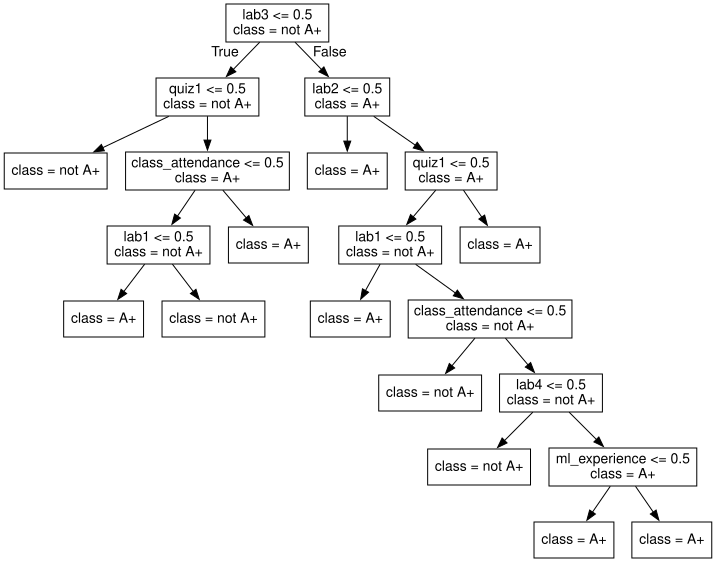

In [10]:
#decision tree classifier is giving much higher accuracy than the dummy classifier. 
display_tree(X_binary.columns, dt_model)  #model visualization

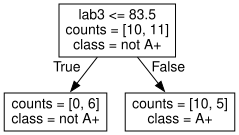

In [11]:
#decision stump example 
ds_model = DecisionTreeClassifier(max_depth=1)
ds_model.fit(X, y)
display_tree(X.columns, ds_model, counts=True)

## ML FUNDAMENTALS

Our model has 0% error for depths >=6. It's becoming  ore and more specific and sensitive to the training data which might not be a good thing

### 3.1 Generalization 
We only have access to limited amount of training data and we want to learn a mapping function which would predict targets reasonably well for examples beyond this training data. 

In [12]:
X = classification_df.drop(columns=["quiz2"])
y = classification_df["quiz2"]

X_subset = X[["lab4", "quiz1"]] # let's consider a subset of the data 
X_subset.head()

,lab4,quiz1
0,91,92
1,83,91
2,80,80
3,91,89
4,92,85


Error: 0.286


/Users/joyzhao/opt/anaconda3/envs/cpsc330/lib/python3.10/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


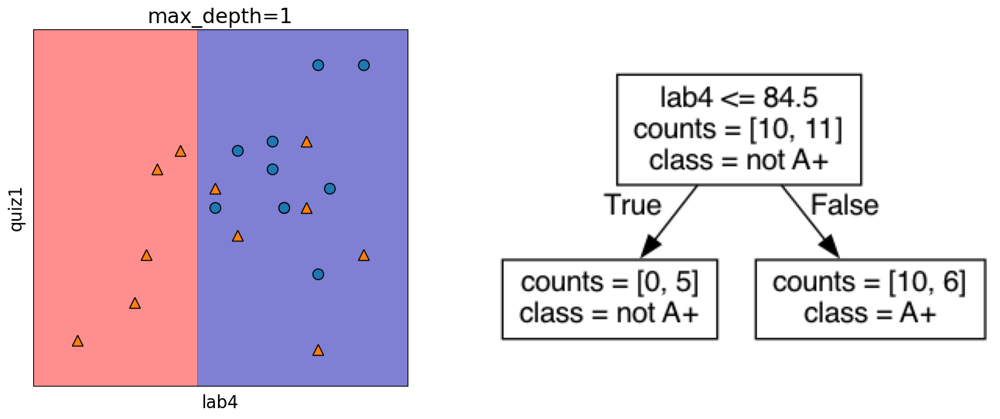

In [13]:
depth = 1 
model = DecisionTreeClassifier(max_depth=depth)
model.fit(X_subset, y)
model.score(X_subset, y)
print("Error: %0.3f" % (1 - model.score(X_subset, y)))
plot_tree_decision_boundary_and_tree(
    model, X_subset, y, x_label="lab4", y_label="quiz1")

Error: 0.000


/Users/joyzhao/opt/anaconda3/envs/cpsc330/lib/python3.10/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


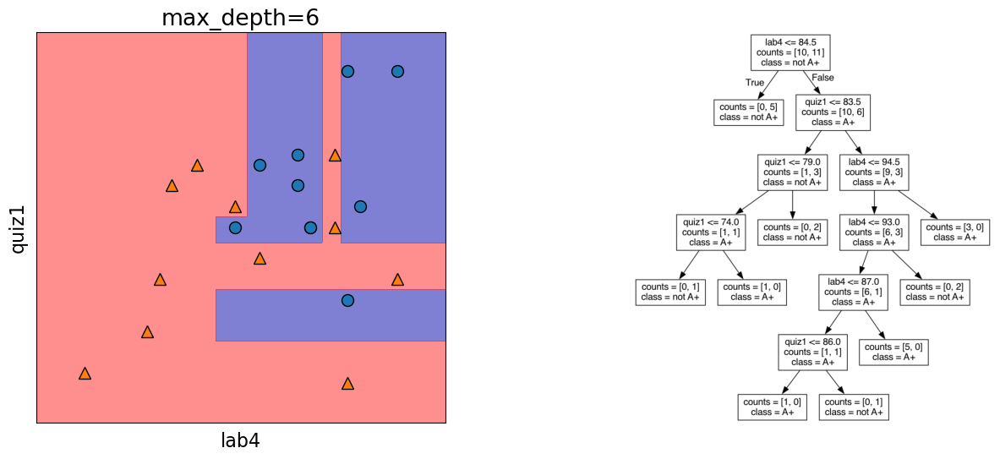

In [14]:
depth = 6
model = DecisionTreeClassifier(max_depth=depth)
model.fit(X_subset, y)
model.score(X_subset, y)
print("Error: %0.3f" % (1 - model.score(X_subset, y)))
plot_tree_decision_boundary_and_tree(
    model, X_subset, y, x_label="lab4", y_label="quiz1")

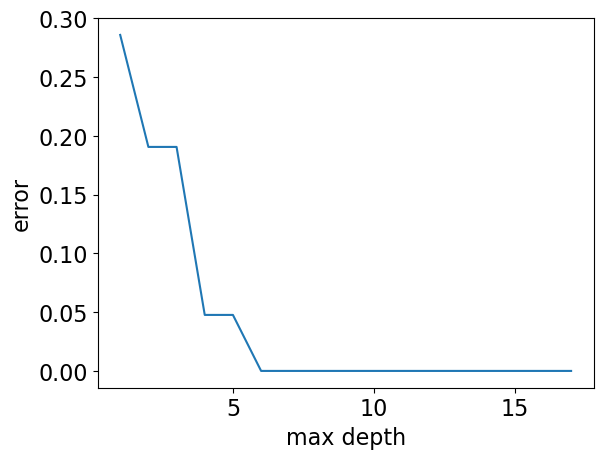

In [15]:
max_depths = np.arange(1,18)
errors = []
for max_depth in max_depths: 
    error= 1- DecisionTreeClassifier(max_depth=max_depth).fit(X_subset, y).score(X_subset, y)
    errors.append(error)
plt.plot(max_depths, errors);
plt. xlabel("max depth");
plt.ylabel("error");

### Training error vs. Generalization error 
1. Error on the traning data: $error_{training}(M)$
2. Error on the entire distribution $D$ of the data: $error_{D}(M)$

#### How to approximate generalization error?
**data splitting**
* Keep aside some randomly selected portion form the training data 
* `fit` (train) a model on the training portion only 
* `score` (assess) the trained model on thsi set aside data to get a sense of how well the mdoel would be able to generalize 
* pretend that the kept aside data is representative of the real distribution $D$ of data

In [16]:
#sklearn.model_selection.train_test_split(*arrays, 
#test_size=None, train_size=None, random_state=None, shuffle=True, stratify=None)

# we can pass X and y or a dataframe with both X and y in it 
# we can also specify the train or test split sizes

df = pd.read_csv("data/canada_usa_cities.csv")
X = df.drop(columns=["country"])
y = df["country"]

from sklearn.model_selection import train_test_split 
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=123
) # 80%-20% train test split on X and y 

# Print shapes
shape_dict = {
    "Data portion": ["X", "y", "X_train", "y_train", "X_test", "y_test"], 
    "Shape": [
        X.shape, 
        y.shape, 
        X_train.shape, 
        y_train.shape, 
        X_test.shape, 
        y_test.shape, 
    ], 
}

shape_df = pd.DataFrame(shape_dict)
HTML(shape_df.to_html(index=False))

Data portion,Shape
X,"(209, 2)"
y,"(209,)"
X_train,"(167, 2)"
y_train,"(167,)"
X_test,"(42, 2)"
y_test,"(42,)"


In [17]:
#sometimes we want to keep the target in the train split for EDA or for visualization 
train_df, test_df = train_test_split(
    df, test_size=0.2, random_state=123
) # 80-20% train test split on df 
X_train, y_train = train_df.drop(columns=["country"]), train_df["country"]
X_test, y_test = test_df.drop(columns=["country"]), test_df["country"]
train_df.head() 

,longitude,latitude,country
160,-76.4813,44.2307,Canada
127,-81.2496,42.9837,Canada
169,-66.0580,45.2788,Canada
188,-73.2533,45.3057,Canada
187,-67.9245,47.1652,Canada


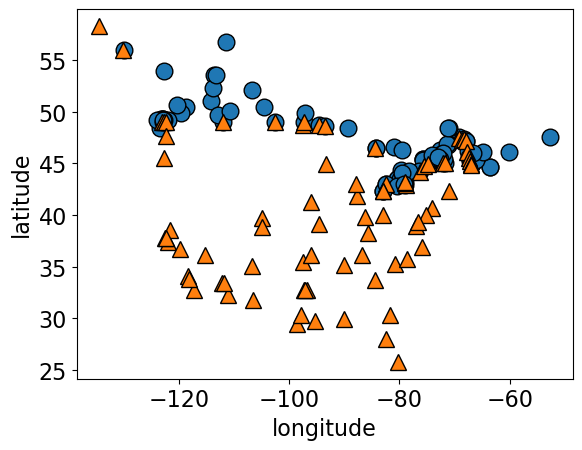

In [18]:
# example in which we split by the dataframe instead 
mglearn.discrete_scatter(X.iloc[:, 0], X.iloc[:, 1], y, s=12)
plt.xlabel("longitude")
plt.ylabel("latitude"); 

In [19]:
model = DecisionTreeClassifier()
model.fit(X_train, y_train) 
#display_tree(X_train.columns, model)
print("Train accuracy: %0.3f" % model.score(X_train, y_train))
print("Test accuracy: %0.3f" % model.score(X_test, y_test))


Train accuracy: 1.000
Test accuracy: 0.762


Therefore, it is predicting our training data perfectly but does not generalize well to our test data. This is not a very reliable model. 
* Useful arguments of `train_test_split`:
    * `test_size`
    * `train_size`
        * this is how we split the data into train and test data 
    * `random_state`
        * data is shuffled before splitting which is a crucial step. 
        * `random_state=123`. If you run this notebook with the same `random_state` it should give the same split. Useful for reproducible results. 

#### Train/validation/test split 
* validation split is used only to score the model. the train split is the only one used for fitting our model. 
* "validation" data: refers to data where we have access to the target values but unlike training data, we only use this for hyperparameter tuning and model assessment. we don't pass these into fit.
* "test" data: refer to data were we also have access to the target values, however, we neither use it in training nor hyperparameter optimization. Only use it once to evaluate the performance of the best performing model on the validation set. "lock it in vault" until ready to evaluate. 
* "deployment" data: refer to data where we do not have access to the target values. Use validation and test errors as proxies for deployment error and hope they are similar
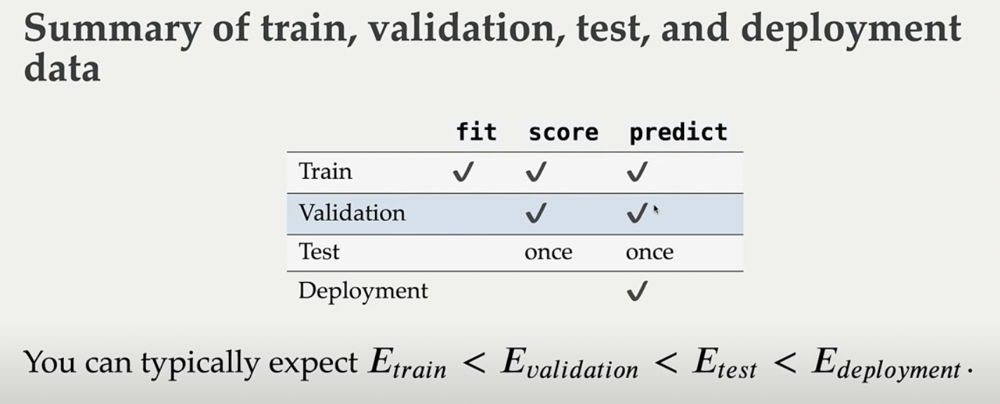

#### 3.3 Cross-Validation
**Problems with single train/validation split**
* only using a portion of your data for training and only a portion for validation. 
* If your dataset is small you might end up with a tiny training and/or validation set 
* might be unlucky with the splits that they won't align well to represent the test data. 

**Cross-validation**
* allows you to get multiple validation sets for one training set. 
* split the datainto $k$ folds $(k >2$, often $k=10)$. 
* Each "fold" gets a turn at being the validation set 
* Note that cross-validation doesn't shuffle the data it's done in `train _test_split`
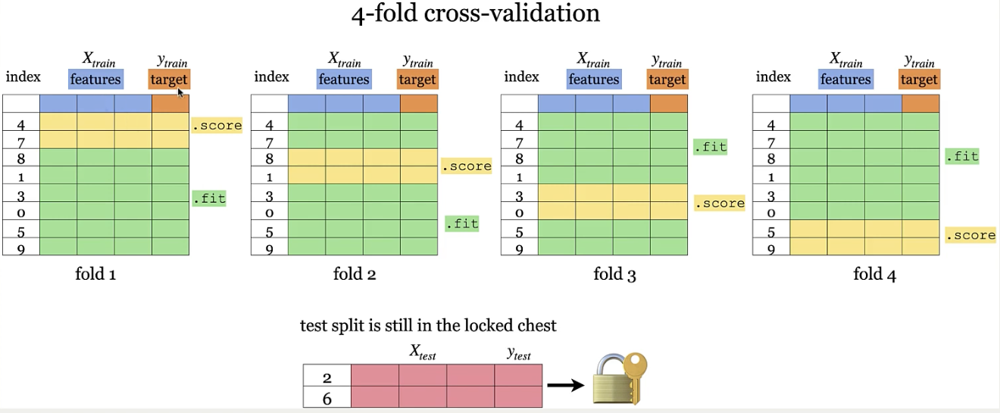

#### `cross_val_score`

In [20]:
from sklearn.model_selection import cross_val_score, cross_validate
model = DecisionTreeClassifier(max_depth=4)
cv_scores = cross_val_score(model, X_train, y_train, cv=10)# asking for 10 fold cross validation 
cv_scores #validation score for each fold we do the fit and score

array([0.76470588, 0.82352941, 0.70588235, 0.94117647, 0.82352941,
       0.82352941, 0.70588235, 0.9375    , 0.9375    , 0.9375    ])

In [21]:
print(f"Average cross-validation score = {np.mean(cv_scores):.2f}")
print(f"Standard deviation of cross-validation score= {np.std(cv_scores):.2f}")

Average cross-validation score = 0.84
Standard deviation of cross-validation score= 0.09


#### `cross_validate`
* Similar to `cross_val_score` but more powerful
* Let's us access training and validation scores. 

In [22]:
scores = cross_validate(model, X_train, y_train, cv=10, return_train_score=True) #10 fold cross validation and return training scores
pd.DataFrame(scores)

,fit_time,score_time,test_score,train_score
0,0.073195,0.037497,0.764706,0.913333
1,0.015322,0.078634,0.823529,0.906667
2,0.011227,0.008095,0.705882,0.906667
3,0.015808,0.045614,0.941176,0.900000
4,0.030639,0.005426,0.823529,0.906667
5,0.036391,0.009275,0.823529,0.913333
6,0.004833,0.005128,0.705882,0.920000
7,0.040162,0.023249,0.937500,0.900662
8,0.005892,0.012948,0.937500,0.900662
9,0.038893,0.013808,0.937500,0.900662


In [23]:
pd.DataFrame(pd.DataFrame(scores).mean())

,0
fit_time,0.027236
score_time,0.023967
test_score,0.840074
train_score,0.906865


### 3.4 Underfitting, Overfitting, the fundamental trade-off, the golden rule 
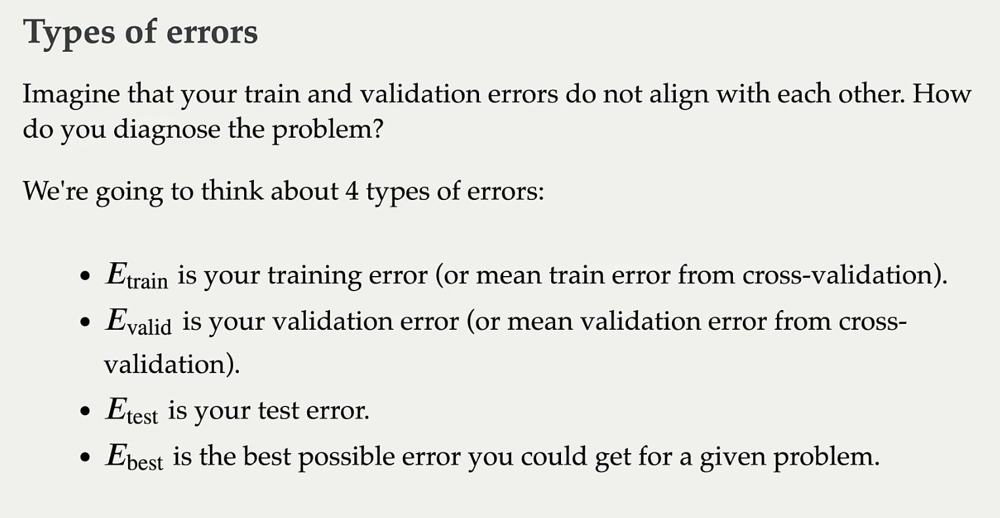
$E_{best}$ is sort of a best imaginary error that you can get if you have a full data distribution. 
#### Underfitting
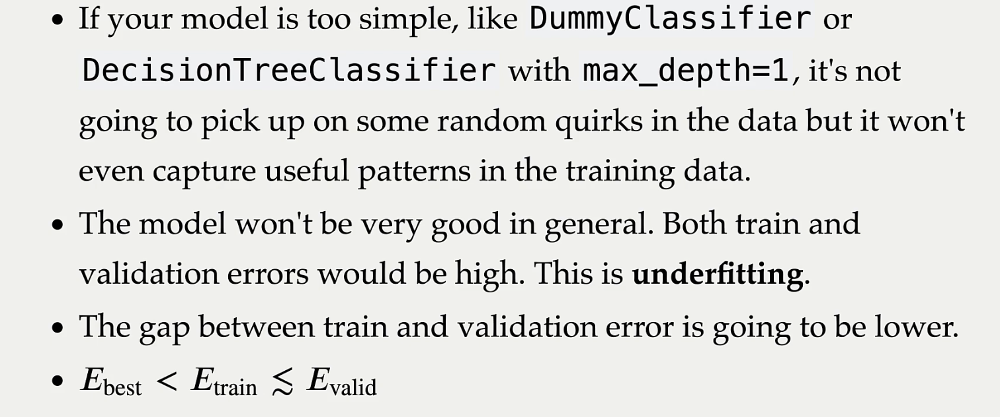

In [24]:
model = DecisionTreeClassifier(max_depth=1) #decision stump
scores = cross_validate(model, X_train, y_train, cv=10, return_train_score=True)
print("Train error: %0.3f" % (1 - np.mean(scores["train_score"])))
print("Validation error: %0.3f" % (1 - np.mean(scores["test_score"])))

Train error: 0.166
Validation error: 0.190


#### Overfitting
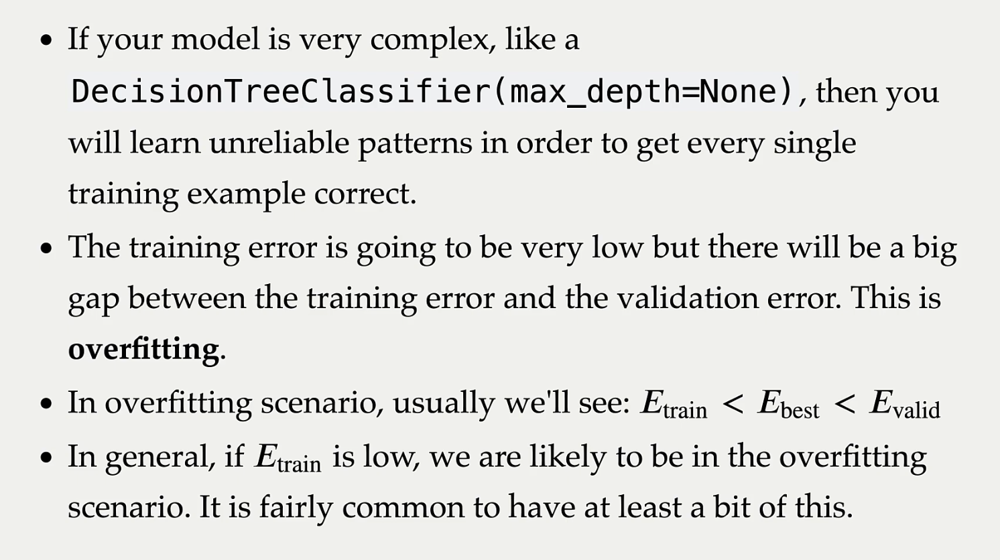
Big gap between training error and validation error. 

In [25]:
model = DecisionTreeClassifier(max_depth=None) 
scores = cross_validate(model, X_train, y_train, cv=10, return_train_score=True)
print("Train error: %0.3f" % (1 - np.mean(scores["train_score"])))
print("Validation error: %0.3f" % (1 - np.mean(scores["test_score"])))

Train error: 0.000
Validation error: 0.185


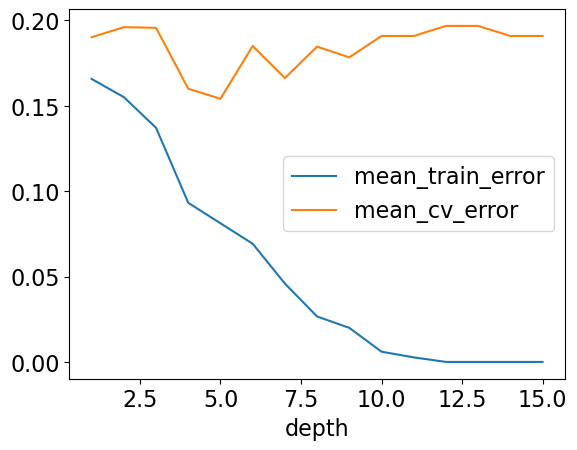

In [26]:
results_dict ={
    "depth": [], 
    "mean_train_error": [], 
    "mean_cv_error": [], 
    "std_cv_error" : [], 
    "std_train_error" : [],
}
param_grid = {"max_depth" :np.arange(1,16)}
for depth in param_grid["max_depth"]:
    model = DecisionTreeClassifier(max_depth=depth)
    scores = cross_validate(model, X_train, y_train, cv=10, return_train_score=True)
    results_dict["depth"].append(depth)
    results_dict["mean_cv_error"].append(1-np.mean(scores["test_score"]))
    results_dict["mean_train_error"].append(1-np.mean(scores["train_score"]))
    results_dict["std_cv_error"].append(scores["test_score"].std())
    results_dict["std_train_error"].append(scores["train_score"].std())
    
                                        
results_df = pd.DataFrame(results_dict)
results_df = results_df.set_index("depth")
results_df[["mean_train_error", "mean_cv_error"]].plot();


The problem of failing to be able to generalize, to the validation data or test data is called **overfitting**

**Fundamental Tradeoff**

As you increase model complexity $E_{train}$ tends to go donw but $E_{valid} - E_{train}$ tends to go up. 
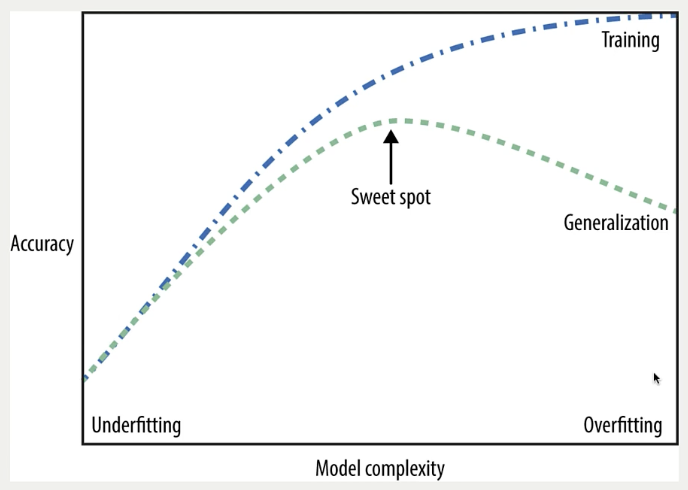


* if data is of good size  and test error is very close to cross-validation error, we can fell confident that the model will give similar performance when deployed

### The Golden Rule 
* Even though we care the most about test error **The test data CANNOT influence the training phase in any way** 
* We have to be very carefully not to violate this rule while developing ML pipeline 
* breaking this rule can lead to misleading results and lack of generalization on the real data 
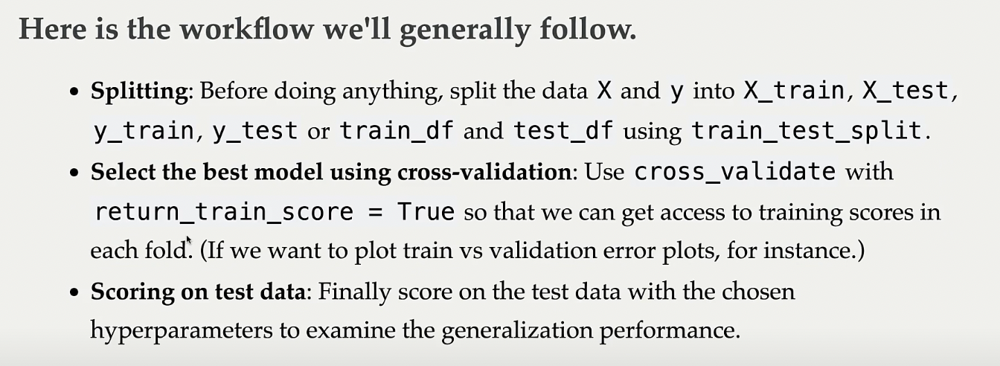

### 4.1 $k$-NNs and SVM with RBF kernel

#### $k$-nearest neighbors algorithm 
* Given a new data point, predict the class of the data point by finding the "closest" data point in the training set, i.e., by finding its "nearest neighbor" or majority vote of the nearest neighbors. 

##### **Geometric view of tabular data and dimensions** 
* To understand analogy-based algorithms it's useful to think of data as points in a high dimensional space 
* Out `X` represents the problem in terms of relevant **features ($d$)** with one dimension for each **feature** (column) 
* examples are **points in a $d$-dimentional space**

##### **Feature vectors**
**Feature vectors**: is composed of feature values associated with an example. 
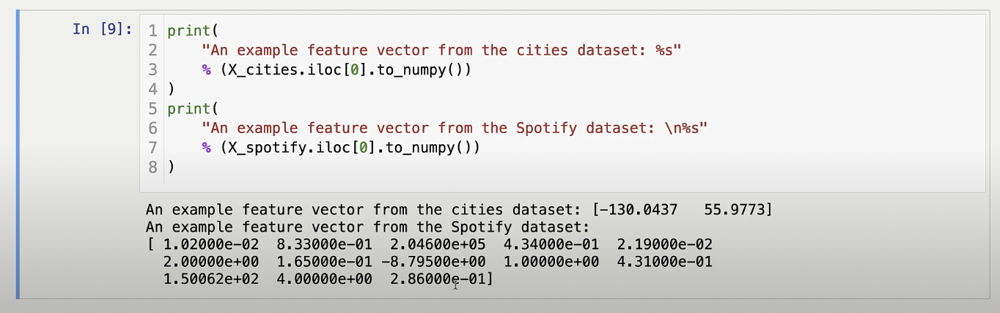

##### Calculate Distance
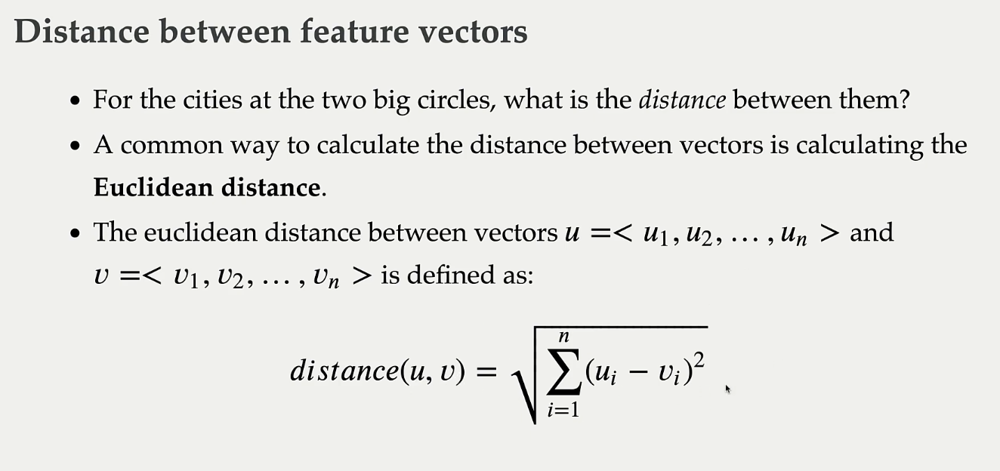

**Finding the distance to a query point**

We can also find the distances to a new "test" or "query" city 


In [27]:
# Euclidean distance using sklearn 
from sklearn.metrics.pairwise import euclidean_distances 
#euclidean_distances(X_train)
#euclidean_distances(X_train, query_point)

### $k$-nearest neighbors algorithm 

* Suppose we want to predict the class of a point:
    * Intuitive way is to predict the same label as the "closest" point (k=1) (1-nearest neighbor) 
    * multiple neighbors (k=3) (3 closest neighbors)
* The primary hyperparameter of the model is `n_neighbors` ($k$) which decides how many neighbours should vote during prediction 


In [28]:
import pandas as pd
from sklearn.neighbors import KNeighborsClassifier 
cities_df = pd.read_csv("data/canada_usa_cities.csv")

X = cities_df.drop(columns= ["country"])
y = cities_df["country"]

# split data into train and test sets 
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size= 0.1, random_state=123
)

#k-neighbor classifier with k=1 
k=1 
knn1 = KNeighborsClassifier(n_neighbors=k)
scores = cross_validate(knn1, X_train, y_train, return_train_score=True)
pd.DataFrame(scores)
# appears to overfit

,fit_time,score_time,test_score,train_score
0,0.041156,0.140293,0.710526,1.0
1,0.062728,0.077769,0.684211,1.0
2,0.034276,0.037191,0.842105,1.0
3,0.040093,0.044350,0.702703,1.0
4,0.026879,0.064412,0.837838,1.0


In [29]:
k=100 
knn100 = KNeighborsClassifier(n_neighbors=k) 
scores = cross_validate(knn100, X_train, y_train, return_train_score=True) 
pd.DataFrame(scores)
# appears to underfit since both the train and the 
# validation score decreased and are about the same 

,fit_time,score_time,test_score,train_score
0,0.006294,0.568916,0.605263,0.600000
1,0.004136,0.067751,0.605263,0.600000
2,0.033271,0.224179,0.605263,0.600000
3,0.007110,0.189984,0.594595,0.602649
4,0.003923,0.192127,0.594595,0.602649


In [30]:
k=11 
knn100 = KNeighborsClassifier(n_neighbors=k) 
scores = cross_validate(knn100, X_train, y_train, return_train_score=True) 
pd.DataFrame(scores)
# better


,fit_time,score_time,test_score,train_score
0,0.012974,0.022747,0.815789,0.826667
1,0.003969,0.008933,0.789474,0.820000
2,0.006222,0.007375,0.842105,0.813333
3,0.005511,0.008546,0.729730,0.834437
4,0.003723,0.005769,0.837838,0.801325


#### `n_neighbors` Hyperparameter
* `n_neighbors` is a hyperparameter that needs to be optimized
* we can plot the `mean_train_score` and `mean_cv_score` on graph to optimize k-value. 

### 4.3 More on $k$-NNs 
* `weights` --> when predicting label, you can assign higher weight to the examples which are closer to the query example
* **Regression Problem with $k$-nearest neighbors**
    * we can take the average of the $k$-nearest neighbors 
    * can also have weighted regression. 
    
**PROS of KNN**
* easy to understand and interpret 
* simple hyperparameter $k$ `n_neighbors` controlling fundamental tradeoff 
* can learn complex functions given enough data 
* take no time to `fit` due to LAZY LEARNING
    * they just store all the examples. 


**CONS of KNN**
* potentially be very slow during prediction time when trainng set is very large sin e it needs to find the distance. (score_time is higher than fit_time, but prediction_time is often more important many times we want real-time predictions)
* often not great test accuracy compared to other modern approaches. 
* does not work well on datasets with many features or where more feature values are 0 most of the time (sparse datasets).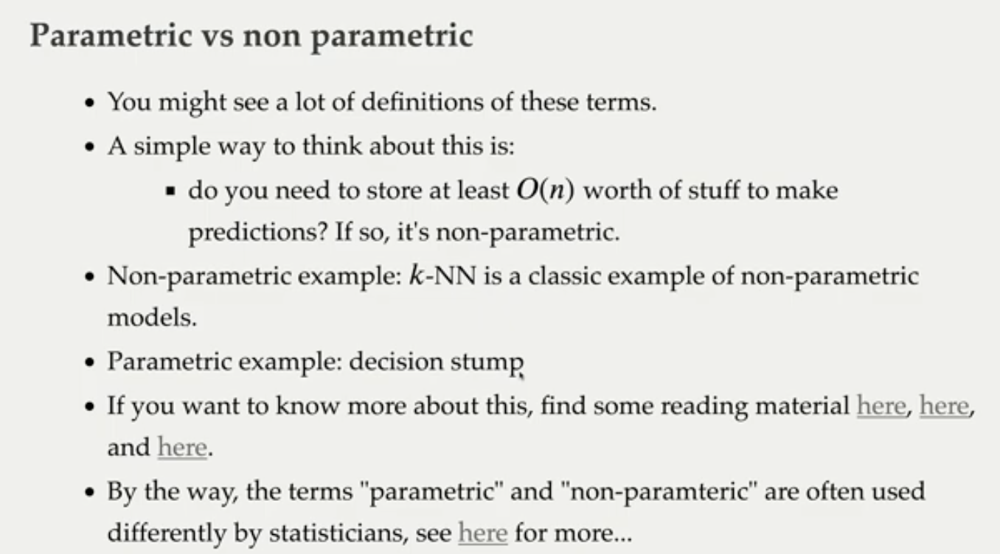


**Curse of Dimensionality**
* affects all learners but epecially bad for nearest-neighbor 
* kNN usually works well when the number of dimensions $d$ is small but fall apart with $d$ goes up. 
* if there are many irrelevant attributes, kNN is confused because all of the attributes contribute to finding similarity between examples. 
* with enough irrelevant attributes the accidental similarity swamps out meaning similarity and kNN is no better than random guessing


### 4.4 Support Vector Machines (SVMs) with RBF kernel 

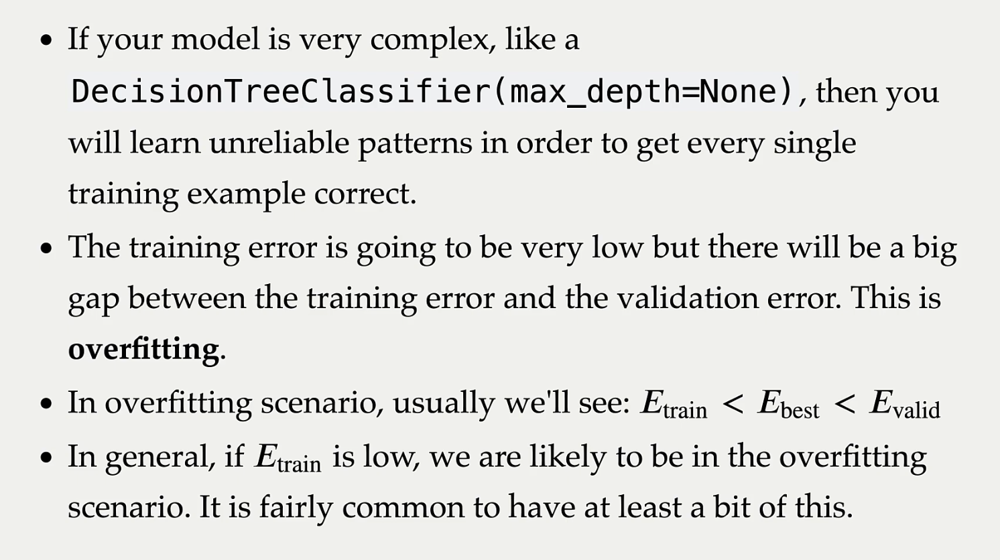

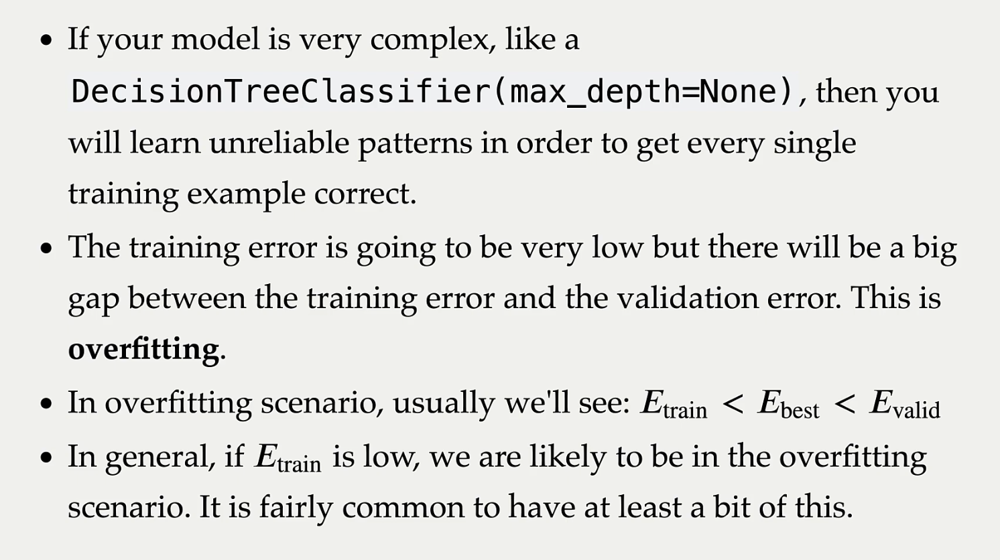

**uses key examples called SUPPORT VECTORS instead than all examples**
* for example the cities dataset (US or Canada) we only need key examples that are on the border. 
* each training example either is or isn't a "support vector" 
    * this gets decided during `fit`. 
* **main insight: the decision boundary only depends on the support vectors**
* Let's look at the support vectors 



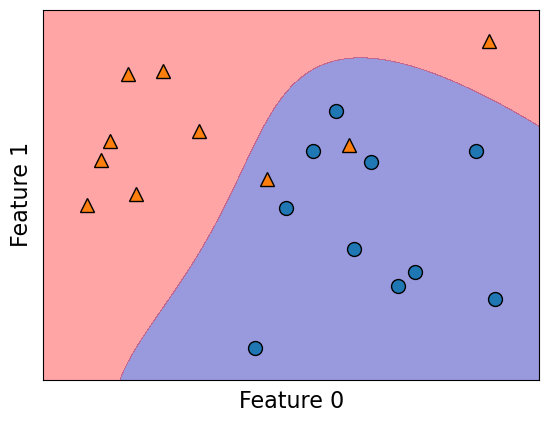

In [31]:
from sklearn.svm import SVC

from sklearn.datasets import make_blobs 
n = 20 
n_classes = 2
X_toy, y_toy = make_blobs(n_samples=n, centers=n_classes, random_state=300) #Let's generate some fake data

mglearn.discrete_scatter(X_toy[:,0], X_toy[:, 1], y_toy) 
plt.xlabel("Feature 0")
plt.ylabel("Feature 1") 
svm = SVC(kernel= 'rbf', C=10, gamma=0.1).fit(X_toy, y_toy)
mglearn.plots.plot_2d_separator(
    svm, X_toy, fill=True, eps=0.5, alpha=0.4)



In [32]:
svm.support_

array([ 3,  8,  9, 14, 19,  1,  4,  6, 17], dtype=int32)

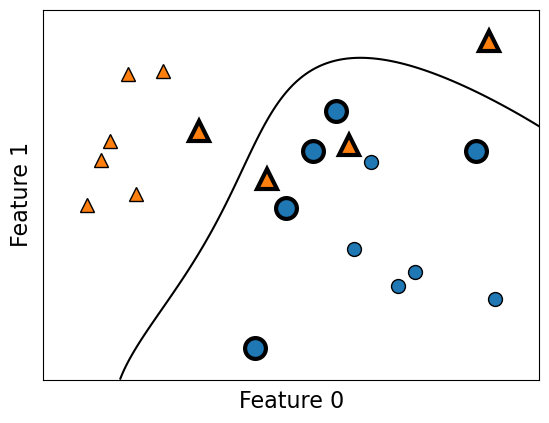

In [33]:
plot_support_vectors(svm, X_toy, y_toy)

#### Hyperparameters of SVM
* Key hyperparameters of `rbf` SVM are 
    * `gamma` 
    * `C` 
* be able to describe their relation to the fundamental tradeoff

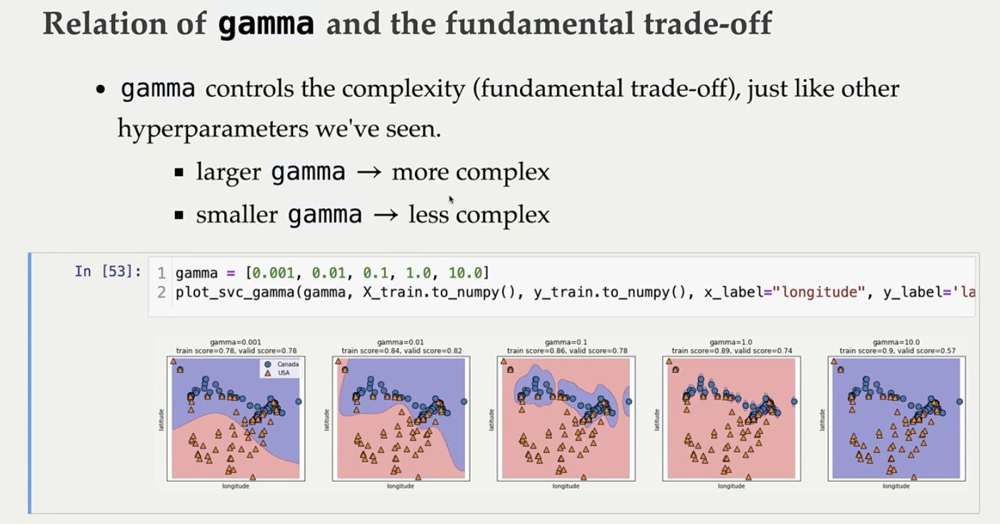

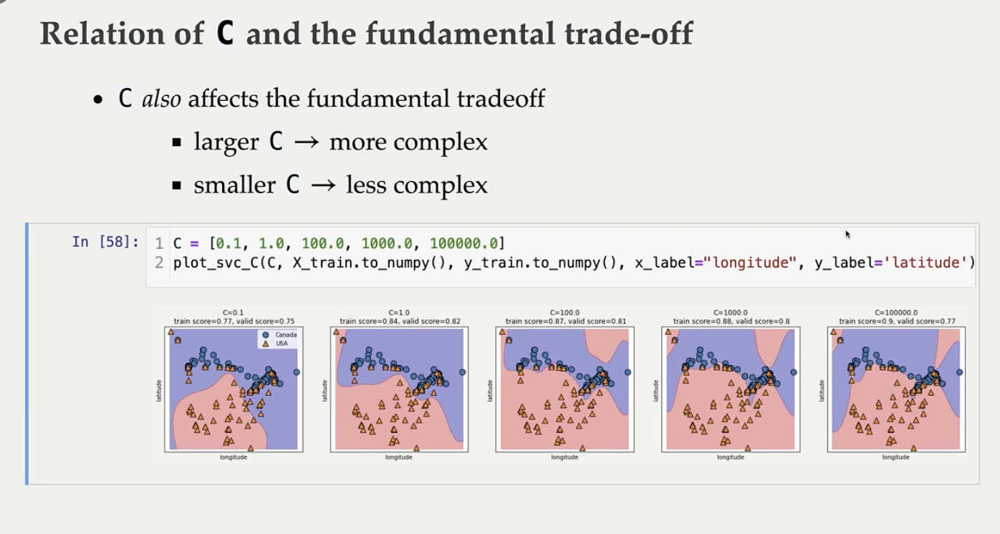

### 5.1 Data Processing Introduction 
**Problem with Scaling **
*  scale is based on how data was collected 
* features on a smaller scale scan be highly informative and there is no good reason to ignore them 
* we want our model to be robust and not sensitive to the scale 
(this is not a problem for decision trees because they look at each feature separately). 


#### Scaling using `scikit-learn`'s <u> StandardScaler</u>
* scikit-learn`'s <u> StandardScaler</u> is a `transformer` 



In [34]:
from sklearn.preprocessing import StandardScaler 
spotify_df = pd.read_csv("data/spotify.csv").iloc[:,1:]
df_train, df_test = train_test_split(spotify_df, test_size=0.2, random_state=321)

X_train = df_train.drop(columns=["target", "song_title", "artist"])
y_train = df_train["target"]
X_test = df_test.drop(columns=["target", "song_title", "artist"])
y_test = df_test["target"]

scaler = StandardScaler() # create feature transformer object 
scaler.fit(X_train) # fitting the transformer on the train split 
X_train_scaled = scaler.transform(X_train) # transforming the train split 
X_test_scaled = scaler.transform(X_test) #transforming the test split
pd.DataFrame(X_train_scaled, columns=X_train.columns).head()

,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence
0,-0.652831,1.936196,-0.664002,0.665468,-0.489948,0.716101,-0.856392,0.981897,-1.275553,1.260310,-0.051822,0.100094,0.229777
1,-0.395557,-0.999838,0.132597,-0.581514,-0.489972,0.442323,-0.586559,0.001161,0.783974,-0.739019,0.888368,0.100094,-0.810391
2,-0.716094,-0.857071,-0.587347,1.385625,-0.488316,0.168544,-0.534003,0.734198,0.783974,0.646531,-0.276623,0.100094,-1.027434
3,-0.571113,0.328515,-0.207919,0.370639,-0.489972,0.442323,0.959368,0.941656,0.783974,0.748828,0.554270,0.100094,0.184730
4,-0.628198,0.781645,-0.299970,0.926464,-0.489972,0.442323,1.042689,0.895161,0.783974,0.407839,1.012917,0.100094,1.278135


### SKlearn

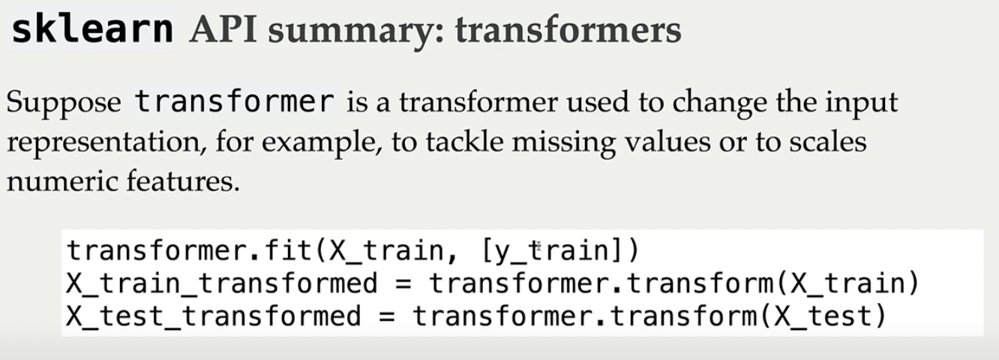

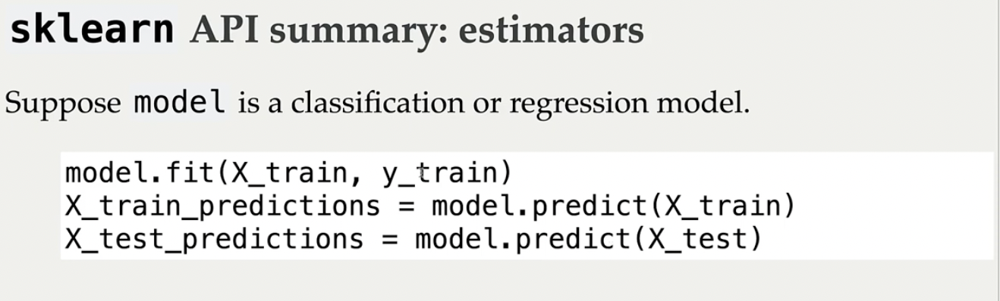
* we never pass our test data to our train function. 
* we don't expect `DummyClassifier` results to change after scaling the data. 
    * this is because the Dummy doesn't even look into the features, they only look at the most common target.
* assess the test set only ONCE!!! 


### 5.2 Imputation and Scaling 


In [35]:
housing_df= pd.read_csv("data/housing.csv")
train_df, test_df = train_test_split(housing_df, test_size=0.1, random_state=123)
train_df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
6051,-117.75,34.04,22.0,2948.0,636.0,2600.0,602.0,3.1250,113600.0,INLAND
20113,-119.57,37.94,17.0,346.0,130.0,51.0,20.0,3.4861,137500.0,INLAND
14289,-117.13,32.74,46.0,3355.0,768.0,1457.0,708.0,2.6604,170100.0,NEAR OCEAN
13665,-117.31,34.02,18.0,1634.0,274.0,899.0,285.0,5.2139,129300.0,INLAND
14471,-117.23,32.88,18.0,5566.0,1465.0,6303.0,1458.0,1.8580,205000.0,NEAR OCEAN


In [36]:
train_df = train_df.assign(
    rooms_per_household= train_df["total_rooms"]/ train_df["households"]
)
test_df = train_df.assign(
    rooms_per_household= test_df["total_rooms"]/ test_df["households"]
)
train_df = train_df.assign(
    bedrooms_per_household= train_df["total_bedrooms"]/ train_df["households"]
)
test_df = test_df.assign(
    bedrooms_per_household= test_df["total_bedrooms"]/ test_df["households"]
)
train_df = train_df.assign(
    population_per_household= train_df["population"]/ train_df["households"]
)
test_df = test_df.assign(
    population_per_household= test_df["population"]/ test_df["households"]
)
train_df.head()



,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,rooms_per_household,bedrooms_per_household,population_per_household
6051,-117.75,34.04,22.0,2948.0,636.0,2600.0,602.0,3.1250,113600.0,INLAND,4.897010,1.056478,4.318937
20113,-119.57,37.94,17.0,346.0,130.0,51.0,20.0,3.4861,137500.0,INLAND,17.300000,6.500000,2.550000
14289,-117.13,32.74,46.0,3355.0,768.0,1457.0,708.0,2.6604,170100.0,NEAR OCEAN,4.738701,1.084746,2.057910
13665,-117.31,34.02,18.0,1634.0,274.0,899.0,285.0,5.2139,129300.0,INLAND,5.733333,0.961404,3.154386
14471,-117.23,32.88,18.0,5566.0,1465.0,6303.0,1458.0,1.8580,205000.0,NEAR OCEAN,3.817558,1.004801,4.323045


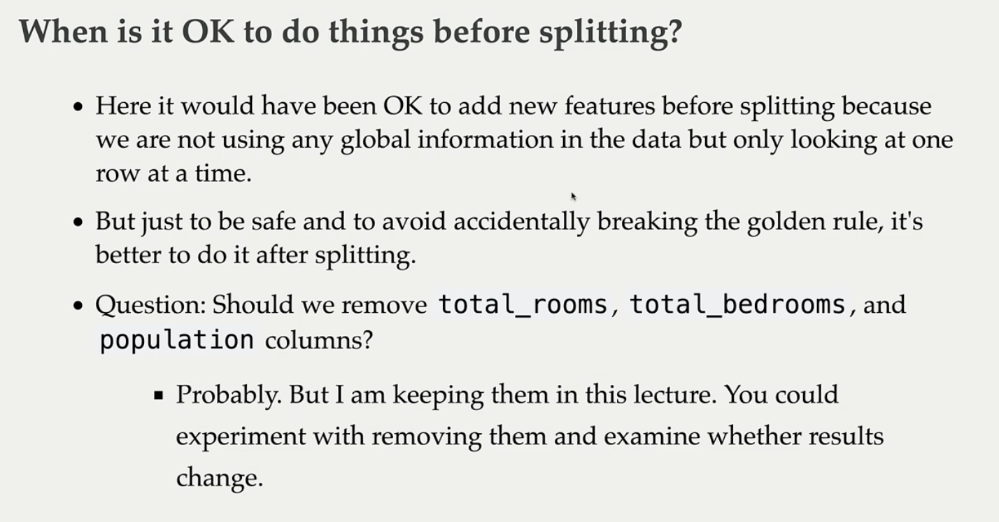

We have one categorical feature and all other features are numerical

* some missing values in `total_bedrooms` column 
* scales are quite different across columns 
* categorical variable `ocean_proximity`  (we can drop this feature)

In [37]:
print(train_df.info())
X_train = train_df.drop(columns=["median_house_value", "ocean_proximity"])
y_train = train_df["median_house_value"]

X_test = test_df.drop(columns=["median_house_value", "ocean_proximity"])
y_test = test_df["median_house_value"]

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18576 entries, 6051 to 19966
Data columns (total 13 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   longitude                 18576 non-null  float64
 1   latitude                  18576 non-null  float64
 2   housing_median_age        18576 non-null  float64
 3   total_rooms               18576 non-null  float64
 4   total_bedrooms            18391 non-null  float64
 5   population                18576 non-null  float64
 6   households                18576 non-null  float64
 7   median_income             18576 non-null  float64
 8   median_house_value        18576 non-null  float64
 9   ocean_proximity           18576 non-null  object 
 10  rooms_per_household       18576 non-null  float64
 11  bedrooms_per_household    18391 non-null  float64
 12  population_per_household  18576 non-null  float64
dtypes: float64(12), object(1)
memory usage: 2.0+ MB
None


In [38]:

# results_dict = {} #dictionary to store our results for different models 

# def mean_std_cross_val_scores(model, X_Train, y_train, **kwargs):
#     scores = cross_validate(model, X_train, y_train, **kwargs) 
#     mean_scores = pd.DataFrame(scores).mean()
#     std_scores = pd.DataFrame(scores).std()
#     out_col = []
    
#     for i in range(len(mean_scores)):
#         out_col.append((f"0.3f (+/- %0.3f)" % (mean_scores[i], std_scores[i])))
#     return pd.Series(data=out_col, index=mean_scores.index)

# # run baseline model DummyRegressor 
# dummy = DummyRegressor(strategy ="median")
# results_dict["dummy"] = mean_std_cross_val_scores(
#     dummy, X_train, y_train, return_train_score=True 
# )

Regression problem when we call score, ti returns R^2 score and r^2 for baseline models is close to zero. 

#### Imputation
* what to do about missing values? 
    * if we straight up delete the rows with missing value, we would be losing data. 
* `SimpleImputer` is a transformer in `sklearn` to deal with this problem:
    * impute missing values in categorical columns with the most frequent value 
    * can impute the missing values in numeric columns with the mean or median of the column

In [39]:
X_train.sort_values("bedrooms_per_household")

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,rooms_per_household,bedrooms_per_household,population_per_household
20248,-119.23,34.25,28.0,26.0,3.0,29.0,9.0,8.0000,2.888889,0.333333,3.222222
12649,-121.47,38.51,52.0,20.0,4.0,74.0,9.0,3.6250,2.222222,0.444444,8.222222
3125,-117.76,35.22,4.0,18.0,3.0,8.0,6.0,1.6250,3.000000,0.500000,1.333333
12138,-117.22,33.87,16.0,56.0,7.0,39.0,14.0,2.6250,4.000000,0.500000,2.785714
8219,-118.21,33.79,33.0,32.0,18.0,96.0,36.0,4.5938,0.888889,0.500000,2.666667
...,...,...,...,...,...,...,...,...,...,...,...
4591,-118.28,34.06,42.0,2472.0,NaN,3795.0,1179.0,1.2254,2.096692,NaN,3.218830
19485,-120.98,37.66,10.0,934.0,NaN,401.0,255.0,0.9336,3.662745,NaN,1.572549
6962,-118.05,33.99,38.0,1619.0,NaN,886.0,357.0,3.7328,4.535014,NaN,2.481793
14970,-117.01,32.74,31.0,3473.0,NaN,2098.0,677.0,2.6973,5.129985,NaN,3.098966


In [40]:
X_train.shape
X_test.shape

(18576, 11)

In [41]:
from sklearn.impute import SimpleImputer
from sklearn.neighbors import KNeighborsRegressor
imputer = SimpleImputer(strategy="median")
imputer.fit(X_train) 
X_train_imp = imputer.transform(X_train)
X_test_imp = imputer.transform(X_test)

In [42]:
knn = KNeighborsRegressor()
knn.fit(X_train_imp, y_train) 
knn.score(X_train_imp, y_train)

0.5085407150708963

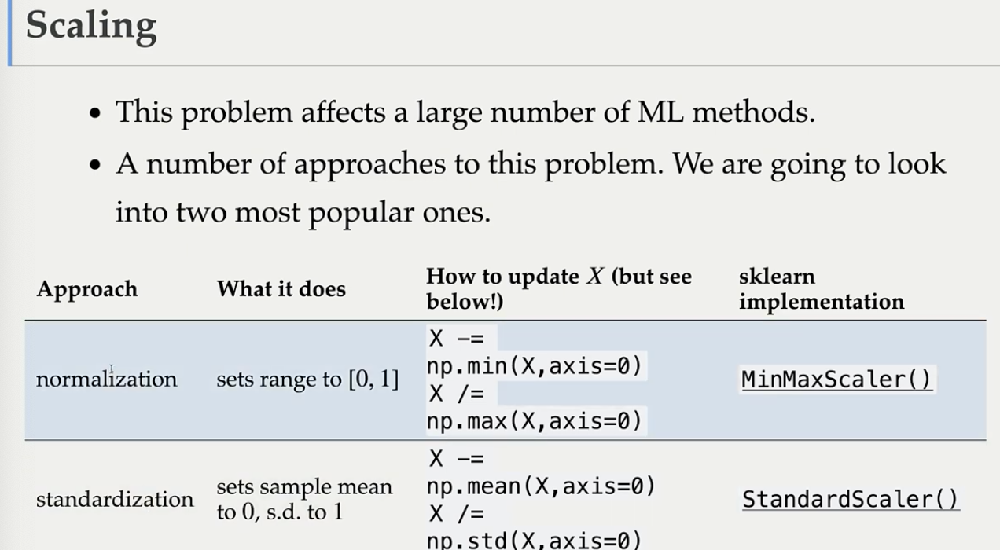



In [43]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler

In [44]:
#fit and transform using the StandardScaler

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_imp) # fit and transform train data
X_test_scaled = scaler.transform(X_test_imp) # for test we only want to transform, we don't want to fit
pd.DataFrame(X_train_scaled, columns= X_train.columns)


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,rooms_per_household,bedrooms_per_household,population_per_household
0,0.908140,-0.743917,-0.526078,0.143120,0.235339,1.026092,0.266135,-0.389736,-0.210591,-0.083813,0.126398
1,-0.002057,1.083123,-0.923283,-1.049510,-0.969959,-1.206672,-1.253312,-0.198924,4.726412,11.166631,-0.050132
2,1.218207,-1.352930,1.380504,0.329670,0.549764,0.024896,0.542873,-0.635239,-0.273606,-0.025391,-0.099240
3,1.128188,-0.753286,-0.843842,-0.459154,-0.626949,-0.463877,-0.561467,0.714077,0.122307,-0.280310,0.010183
4,1.168196,-1.287344,-0.843842,1.343085,2.210026,4.269688,2.500924,-1.059242,-0.640266,-0.190617,0.126808
...,...,...,...,...,...,...,...,...,...,...,...
18571,0.733102,-0.804818,0.586095,-0.875337,-0.243446,-0.822136,-0.966131,-0.118182,0.063110,-0.099558,0.071541
18572,1.163195,-1.057793,-1.161606,0.940194,0.609314,0.882438,0.728235,0.357500,0.235096,-0.163397,0.007458
18573,-1.097293,0.797355,-1.876574,0.695434,0.433046,0.881563,0.514155,0.934269,0.211892,-0.135305,0.044029
18574,-1.437367,1.008167,1.221622,-0.499947,-0.484029,-0.759944,-0.454427,0.006578,-0.273382,-0.149822,-0.132875


In [45]:
knn = KNeighborsRegressor()
knn.fit(X_train_scaled, y_train)
knn.score(X_train_scaled, y_train)

0.8090877831586284

In [46]:
# fit and transform using MinMaxScaler()
#all values here are in range 0 to 1 now
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train_imp)
X_test_scaled = scaler.transform(X_test_imp)
pd.DataFrame(X_train_scaled, columns=X_train.columns) 

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,rooms_per_household,bedrooms_per_household,population_per_household
0,0.657371,0.159405,0.411765,0.074928,0.098541,0.072788,0.098832,0.181039,0.028717,0.021437,0.002918
1,0.476096,0.573858,0.313725,0.008749,0.020019,0.001345,0.003124,0.205942,0.116642,0.182806,0.001495
2,0.719124,0.021254,0.882353,0.085279,0.119025,0.040752,0.116264,0.148998,0.027594,0.022275,0.001099
3,0.701195,0.157279,0.333333,0.041508,0.042365,0.025113,0.046703,0.325099,0.034645,0.018619,0.001981
4,0.709163,0.036132,0.333333,0.141513,0.227188,0.176574,0.239599,0.093661,0.021064,0.019905,0.002922
...,...,...,...,...,...,...,...,...,...,...,...
18571,0.622510,0.145590,0.686275,0.018414,0.067349,0.013649,0.021214,0.216480,0.033591,0.021211,0.002476
18572,0.708167,0.088204,0.254902,0.119157,0.122905,0.068191,0.127939,0.278562,0.036654,0.020296,0.001959
18573,0.257968,0.509033,0.078431,0.105575,0.111421,0.068163,0.114455,0.353836,0.036241,0.020699,0.002254
18574,0.190239,0.556854,0.843137,0.039244,0.051676,0.015639,0.053445,0.232762,0.027598,0.020490,0.000828


In [47]:
knn = KNeighborsRegressor()
knn.fit(X_train_scaled, y_train) 
knn.score(X_train_scaled, y_train)
# trainin score improved a lot 

0.8069808827506428

### 5.3 SK-learn Pipelines 

#### How to carry out cross-validation? 
* we must apply `fit_transform` on train portion and `transform` only on validation portion in each fold?
    * if we do fit on all the data before we perform cross-validation, we are allowing information from the validation set to **leak** into the training step.
    * thus we need to apply the same preprocessing steps to train/validation 
    
#### Pipelines 
* `scikit-learn Pipeline` allows you to define a "pipeline" of transformers with a final estimator 

* syntax: pass in a list of steps 
* last step should be a **model/classifier/regressor**
* all the earlier steps should be **transformers** 

In [61]:
# simple example of a pipeline 
from sklearn.pipeline import Pipeline 

pipe = Pipeline(
    steps = [
        ("imputer", SimpleImputer(strategy="median")),
        ("scaler", StandardScaler()),
        ("regressor", KNeighborsRegressor())
    ]
)

# Alternative and more compact syntax make_pipeline 
# from sklearn.pipeline import make_pipline
# pipe = make_pipeline(SimpleImputer(strategy= "median"), 
#                      StandardScaler(), #we don't need to name these steps
#                      KNeighborsRegressor())



In [63]:
pip.fit(X_train, y_train)

Pipeline(steps=[('imputer', SimpleImputer(strategy='median')),
                ('scaler', StandardScaler()),
                ('regressor', KNeighborsRegressor())])

When you call `fit` on the pipeline, it carries out the following steps:
* Fit `SimpleImputer` on `X_train`
* Transform `X_train` using the fit `SimpleImputer` to create `X_train_imp` 
* Fit `StandardScaler` on `X_train_imp` 
* Fit the model (`KNeighborsRegressor` in our case) on `X_train_imp_scaled`
* Predict using the fit model (`KNeighborsRegressor` in our case) on `X_train_imp_scaled`
* Using a `Pipeline` takes care applying the `fit_transform` on the train portion and only `transform` on the validation portion in each fold. 

In [66]:
#pipe.predict(X_train)

### 5.4 One-Hot Encoding 

* KNN can't calculate distance is it is a categorical feature 
     * option: drop the column (if we know the column is not relevant to the target) 
* transform categorical features to numeric ones so that we can use them in the model. 
    * Ordinal encoding (occasionally recommended)
    * One-hot encoding (recommended in most cases)

In [68]:
from sklearn.preprocessing import OrdinalEncoder 

enc = OrdinalEncoder() 
enc.fit(X_toy) 
X_toy_ord = enc.transform(X_toy) 
df = pd.DataFrame(
    data= X_toy_ord, 
    columns=["language_enc"], 
    index= X_toy.index, 
) 
pd.concat([X_toy, df], axis=1)

### One-hot encoding (OHE) 
* create new binary columns to represent our categories 
* if we have $c$ categories in our column 
    * we create $c$ new binary columns to represent those categories 
* Example: Imagine a language column which ash the information on how close or how similar two languages are. (we can use sklearn's `OneHotEncoder` here to turn the categorical value to numerical here)

In [71]:
from sklearn.preprocessing import OneHotEncoder
ohe = OneHotEncoder(sparse=False, dtype="int") 

transformed_ohe = pd.DataFrame(
    data = X_imp_train 
    column =ohe.get_feature_names(["ocean_proximity"])
)
transformed_ohe


SyntaxError: invalid syntax. Perhaps you forgot a comma? (2703745807.py, line 4)

### 6.1 Scikit-Learn ColumnTransformer 

*  `ColumnTransformer` helps us apply different transformations on different columns of data 
* Scaling on numeric features
* intentify the transformations we want to apply to each column. 


In [77]:
from sklearn.compose import ColumnTransformer

# ct = ColumnTransformer(
#     [
#         ("scaling", StandardScaler(), numeric_feats), # scaling on numeric features
#         ("onehot", OneHotEncoder(sparse=False), categorical_feats), #OHE on categorical features
#         ("passthrough", passthrough_feats), # no transformation on the binary feature
#         ("drop", drop_feats), # drop the features
#     ]
# )
# transformed = ct.fit_transform(X) 

* When we `fit_transform`, each transformer is applied to the specified columns and the result of  the transformations are concatenated horizontally 
* A big advantage here is that we build all our transformations together into one object, and that way we're sure we do the same operations to all splits of the data 
* Otherwise we might, for example, do the OHE on both train and test but forget to scale the test data.
* note that the order of the columns in the transformed data depends upon the order of the features we 

### 6.1 Spam/ non spam toy example:
* what if the features is in the form of raw text?
* The feature `sms` below is either categorical nor ordinal. 
* How can we encode it so that we can pass it to the machine learning algorithms we have seen so far?

**Apply OHE?**
* each text message will have it's own column. This type of encoding will not work for text data 

#### Bag of words (BOW) representation 
* One of the most popular representation of raw text 
* Ignores the syntax and word order
* Has two components: 
    * the vocabulary (all unique words in all documents)
    * A value indicating either the presence or absence or the count of each word in the document 
    
**Extracting BOW features using `scikit-learn`**
* `CountVectorizer` 
    * Converts a collection of text documents to a matric of word counts 
    * Each row represents a "document" (e.g. a text message in our example)
    * Each column represents a word in the vocabulary (the set of unique words) in the training data 
    * Each cell represents how often the word occurs in the document.
    
**Why sparse matrices**
* most words do not appear in a given document 
* we get massive computational savings if we only store the nonzero elements 
* there is a bit of overhead, because we also ened to store the locations 
* however, if the fraction of nonzero is small, this is a huge win in terms of computation. 
    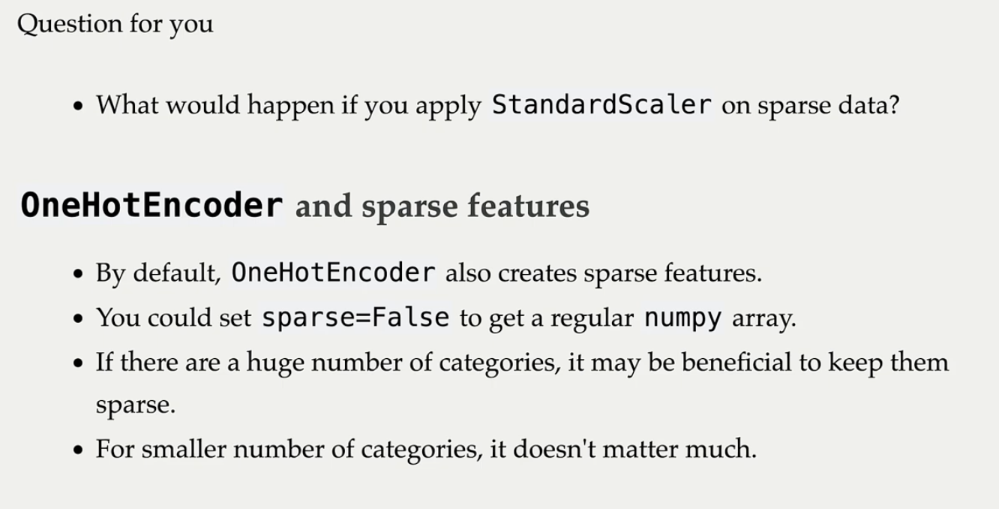
    
    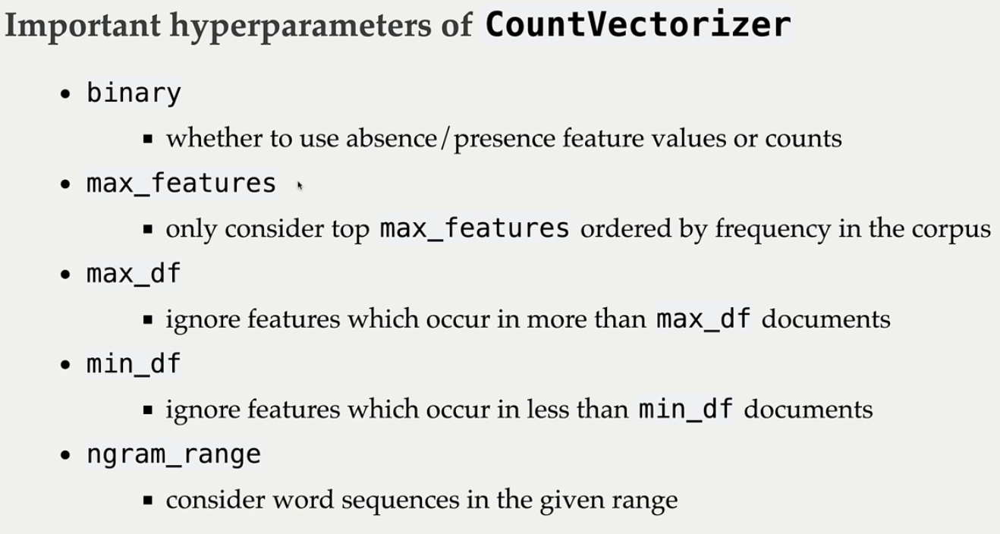

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer 


#### Is this a realistic representation of text data?
* Of course this is not a great representaiton of language 
    * throughout out everything we know about language and losing a lot of information 
    * assumes that there is no syntax and compositional meaning in language 
* works surprisingly well for many tasks 


### 7.1 Linear Regression
**Linear models** is a fundamental and widely used class of models. They are called **linear** because they make a prediction using a **linear function** of the input features 
* Linear regression (regression problems)
* Logistic regression (classification problems)
* Linear SVM (Support vector machine)

#### What are we learning exactly?
* model above is a line, which can be represented with a slope(i.e., coefficient or weight ) and an intercept 
* For the above model, we can access the slope( i.e. coefficient or weight) and the intercept using coef_ and intercept_

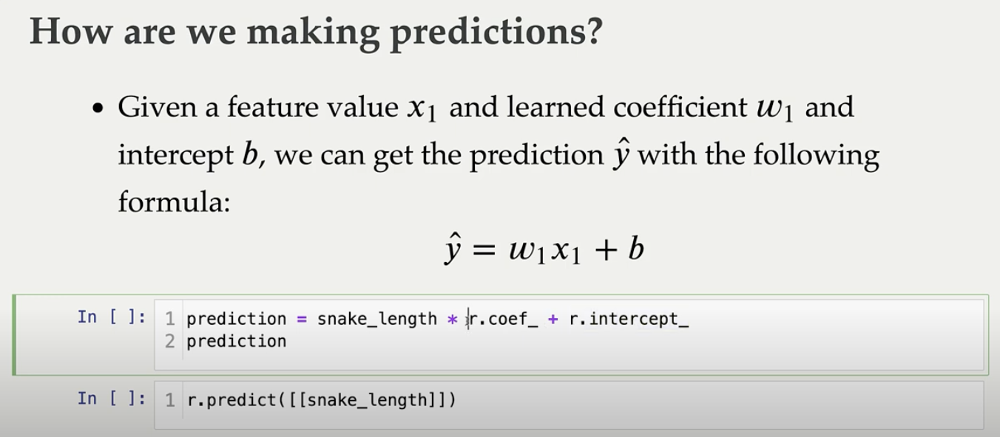

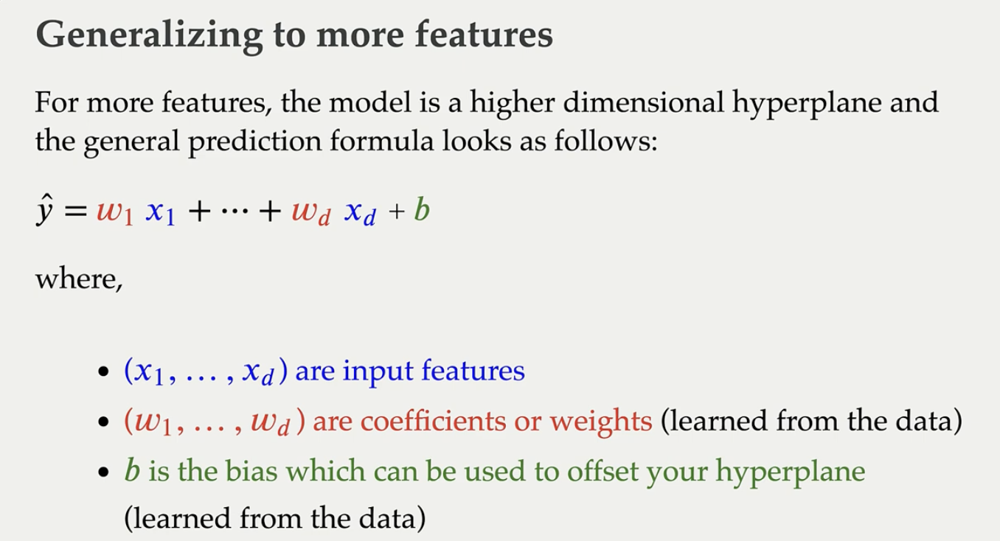

linear combination of these different features, weighted summation of features plus the bias term will give the prediction. 

In [3]:
from sklearn.linear_model import Ridge


#### Effect of alpha on the results
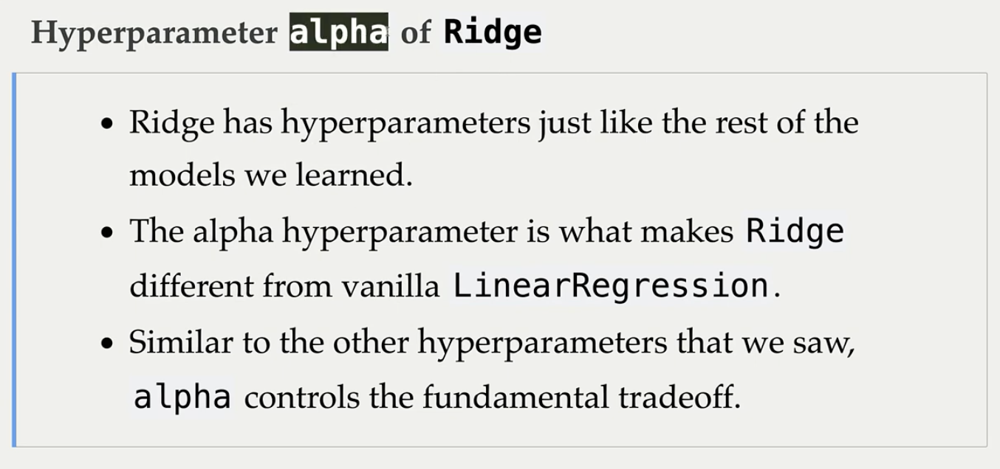
* larger `alpha` --> likely to underfit 
* smaller `alpha` --> likely to overfit 

The model also learns an intercept (bias). For each prediction we are adding this amount irrespective of the feature values. How can we use this information to interpret model predictions? 



### 7.2 Logistic Regression 

* linear model for **classification**
* learns weights associated with each feature and the bias 
* applies a threshold on the raw output to decide whether the class is positive or negative 
    *`predict`, `predict_proba`
    * how to use learned coefficients to interpret the model
    
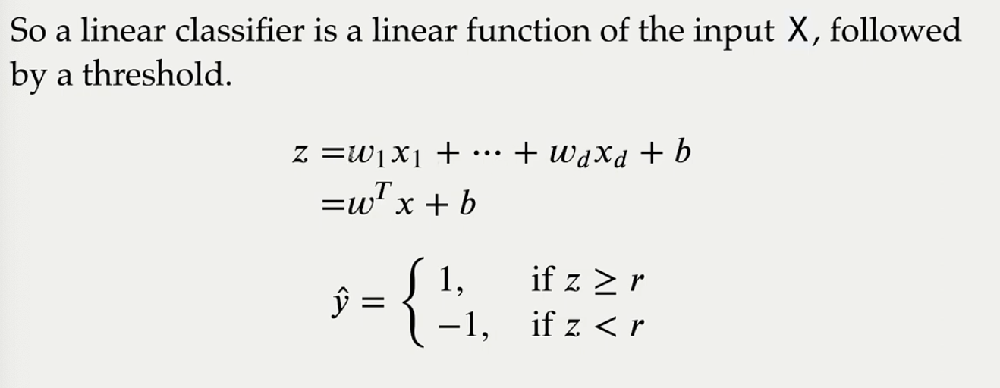
    
#### 
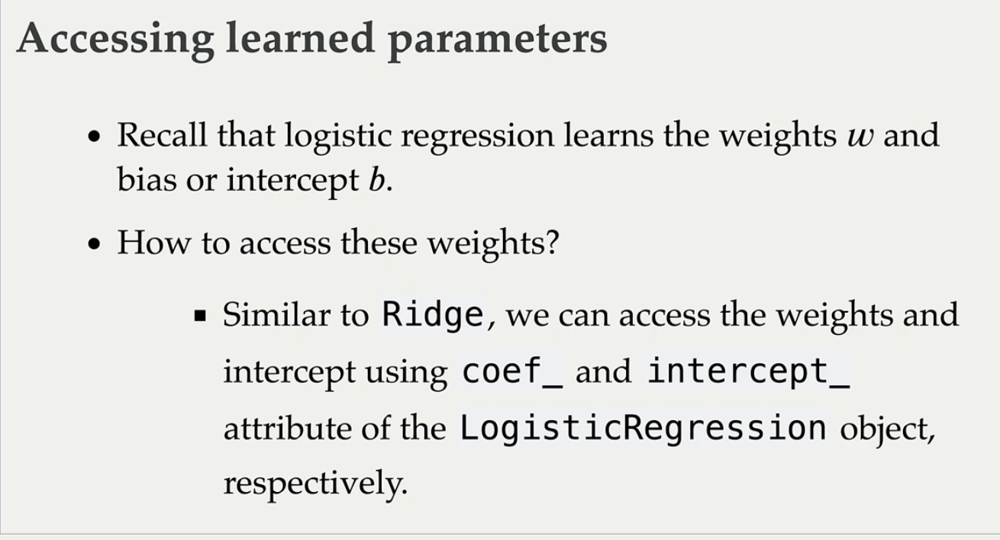

* with logistic regression, the model randomly assigns one of the classes as a positive class and the other as negative
    * usually it would alphabetically order the target and pick the first one as negative and second one as the positive class
* `classes_` attribute tells use which class is considered negative and which one is considered positive.

#### Raw scores 
* calculate the raw score as `y_hat = np.dot(w,x)+b`
    * calculating the weighted sum of the feature and adding the intercept to it and applying the threshold. 
    
#### Decision boundary of logistic regression 
* the decision boundary of logistic regression is a **hyperplane** dividing the feature space in half. 
* for logistic regression. if we have d-features the decision boundary will be a d-1 dimensional hyperplane. 
* in low dimensional space its more effective

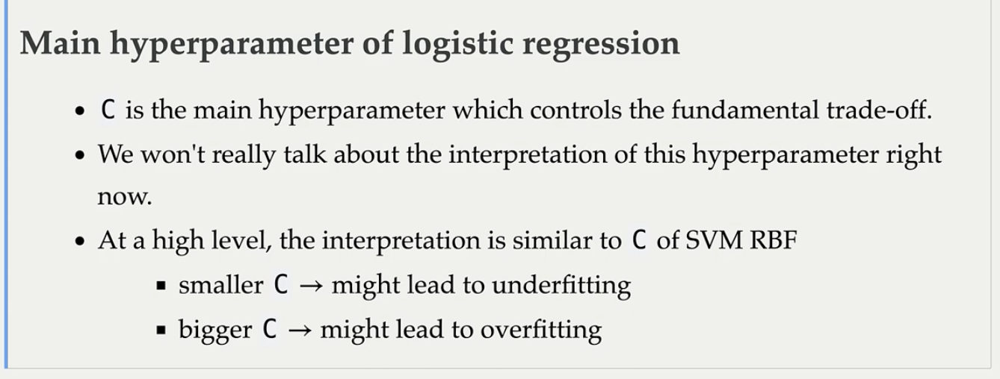

In [ ]:
from sklearn.linear_model import LogisticRegression



### 7.3 Predicting Probability Scores

#### predict_proba

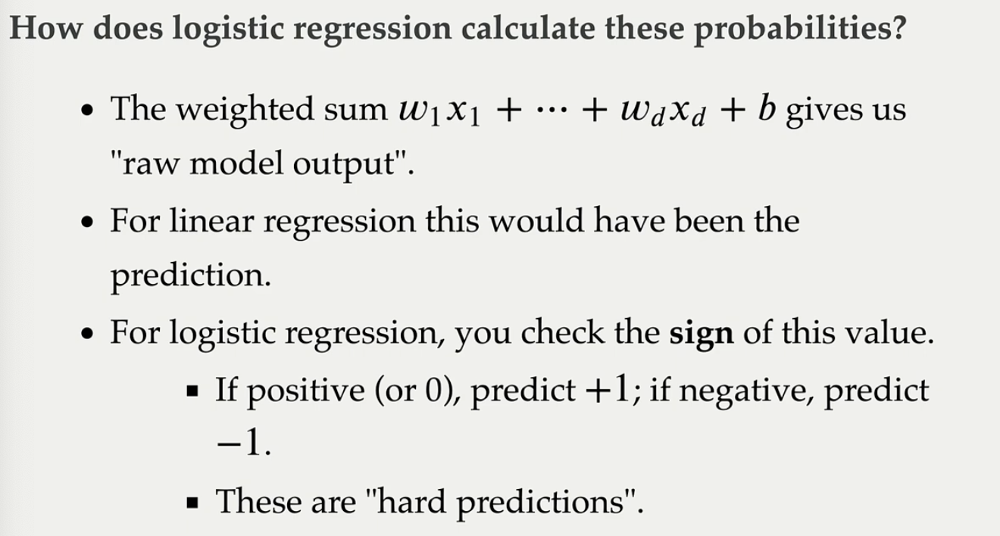

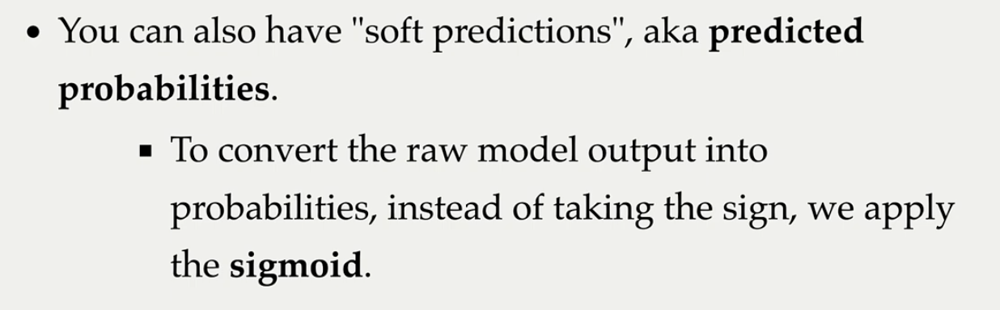

The sigmoid function "Squashes" the raw model output form any number to the range of [0,1] using the following formula, where $x$ is the raw model output 
Then we can interpret the output as probabilities. 
if prediction <0.5 hard prediction would be negative class 
if prediction >0.5 hard prediction would be positive class. 
y_hat is the prediction

### 8.1 Hyperparameter Optimization 
* to improve the generalization performance, finding the best values for the important hyperparameters of a model is necessary for almost all models and datasets. 
* picking good hyperparameters is important because if we don't do it, we might end up with an underfit or overfit model. 

**Manual hyperparameter optimization**
* Advantage: we may have some intuition about what might work. 
    * if massively overfitting, try dereasing `max_depth` or `C` 
* Disadvantages
    * takes lots of work 
    * not reproducible 
    * in complicated cases, our intuition might be worse than a data-driven approach. 
    
**Automated hyperparameter optimization**
* Formulate the hyperparameter optimization as aone big search problem 
* often we have many hyperparameters of different types: (Categorical, integer, and continuous 
* Often the search space is quite big and systematic search for optimal values is infeasible 

#### automated optimizations methods from `scikit-learn` 
* Exhuastive grid search: `sklearn.model_selection.GridSearchCV`
* Randomized search: 
`sklearn.model_selection.RandomizedSearchCV`

### 8.2 Optimization bias/ Overfitting of validation set 
* if our dataset is small and if your validation set is hit too many times, we suffer from optimization bias or overfitting the validation set. 
    * we might optimize the validation error over 1000 values of max_depth 
    * one of the 1000 trees might have low validation error by chance 
    * cv error is not representative to the test error. 

**This is why we need a test set**
* if our data set is small then our test set is also small. 
* but we don't have many better alternative if we have a small dataset

**When test score is much lower than CV score**
* Try simpler models and use the test set a couple of times
* Communicate this clearly when reporting results.

**Large datasets solve many of these problems**
* With infinite amounts of training data, overfitting would not be a problem and you could have your test score = your train score 
    * Overfitting happens because you only see a bit of data and you learn patters that are overly specific to your sample 
    * if you saw "all" the data, then the notion of "overly specific" would not apply 
* So, more data will make your test score better and more robust. 

### 9.2 Confusion matrix
* false positives (type I errors), where the model incorrectly spots examples as fraud 
* false negative (type II errors), where it's missing to spot fraud examples

* in the case of spotting problems, the thing that we are interested in spotting is considered positive. 
* above we wanted to spot fraudulent transactions and so they are positive 

* you can also calculate confusion with cross-validation using the `cross_val_predict` method 
* but then you cannot conveniently use `plot_confusion_matrix`

In [6]:
from sklearn.model_selection import cross_val_predict
#confusion_matrix(y_train, cross_val_predict(pipe, X_train, y_train))

### Precision, Recall, F1 score

* recall 
* precision
* f1 score 
* note that these metrics will only help us assessing our model 
* Later we'll talk about a few ways to address class imbalance problem
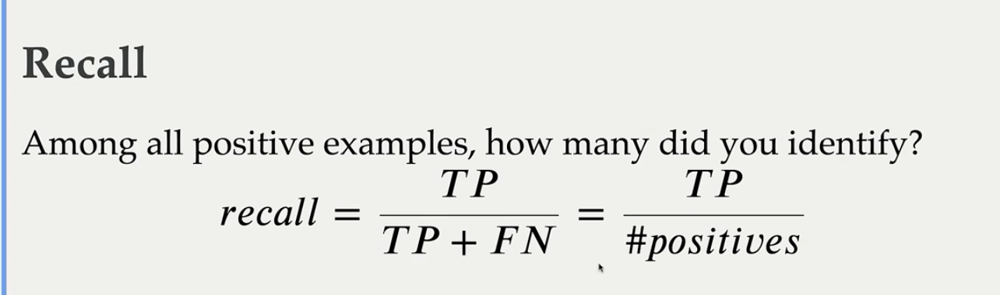

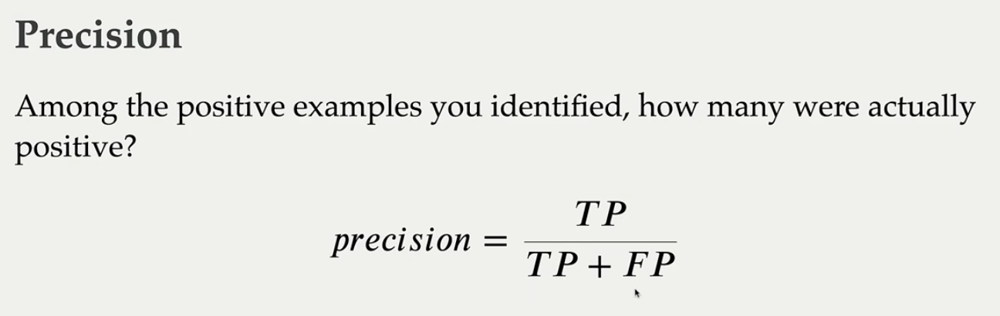

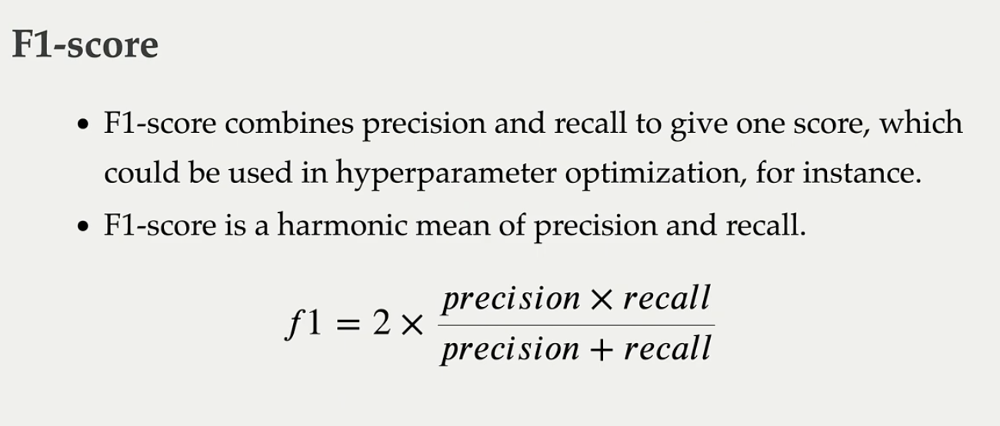


`classification_report`
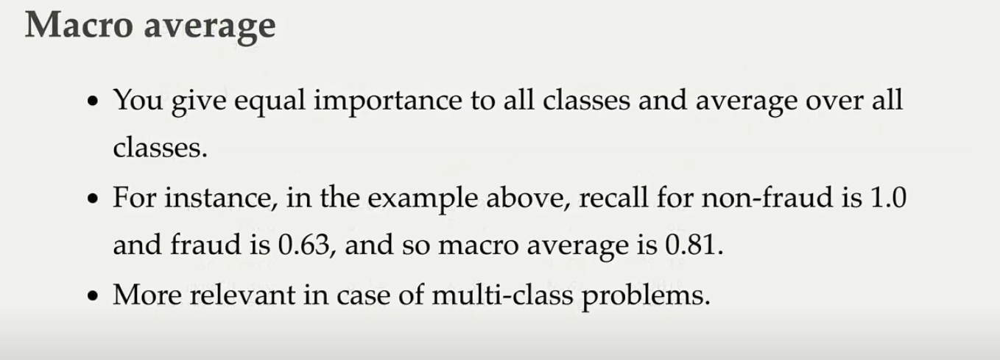

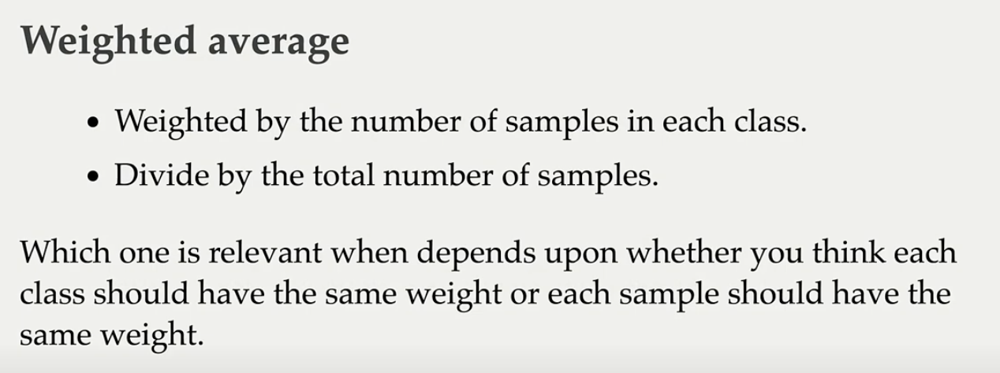

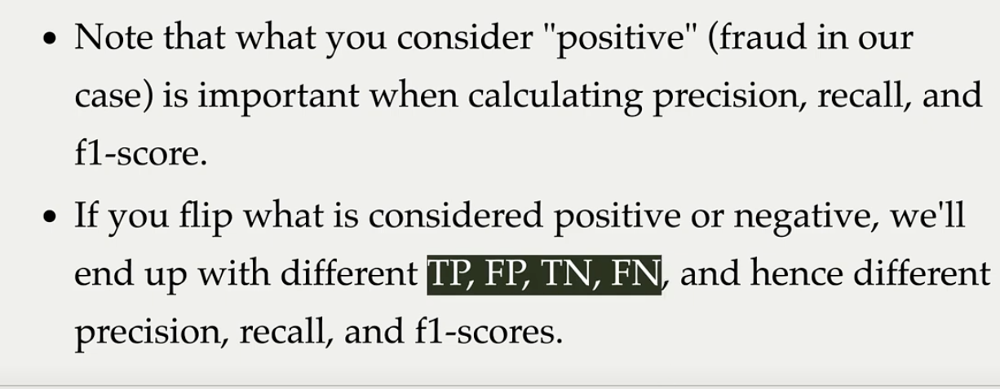

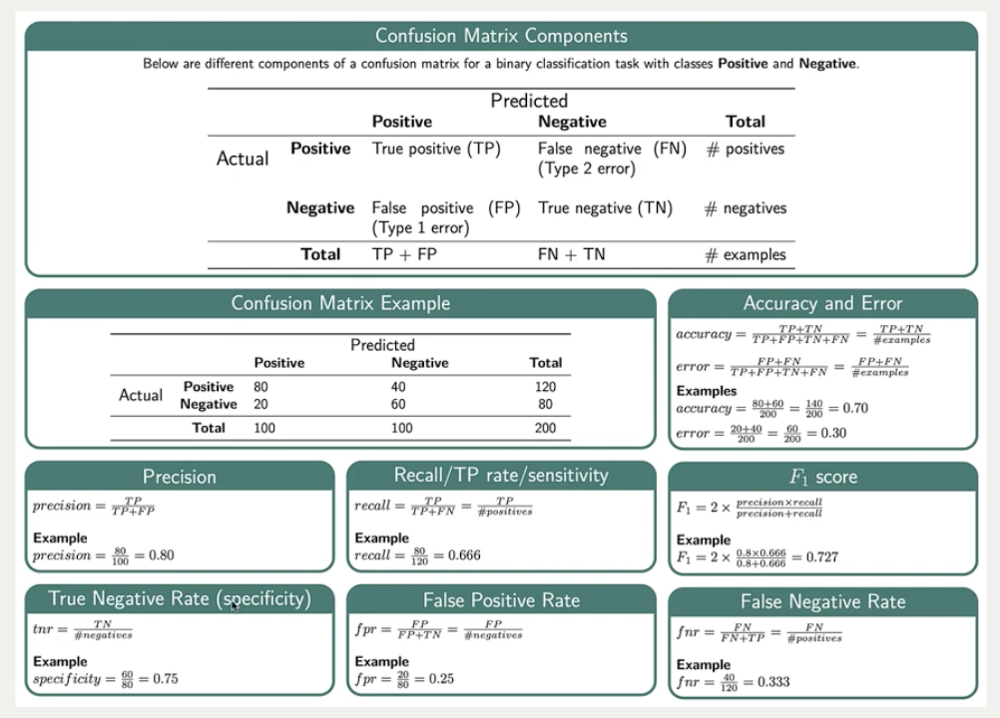

### 9.4 Class imbalance in training sets

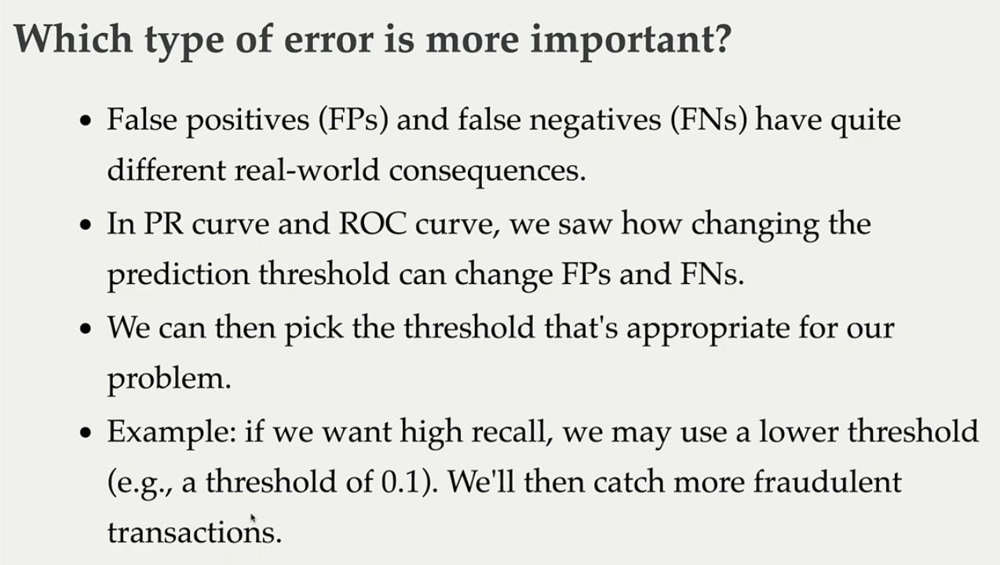

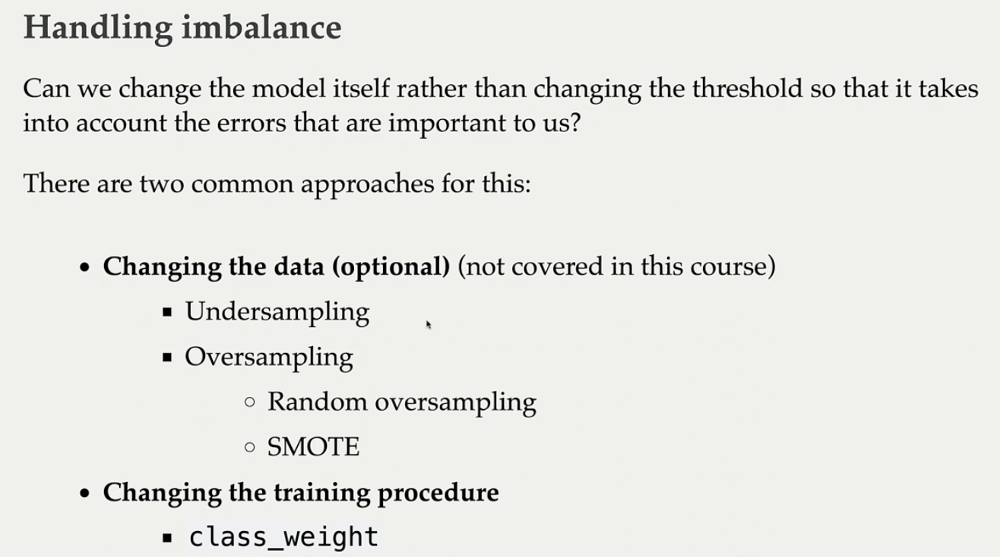

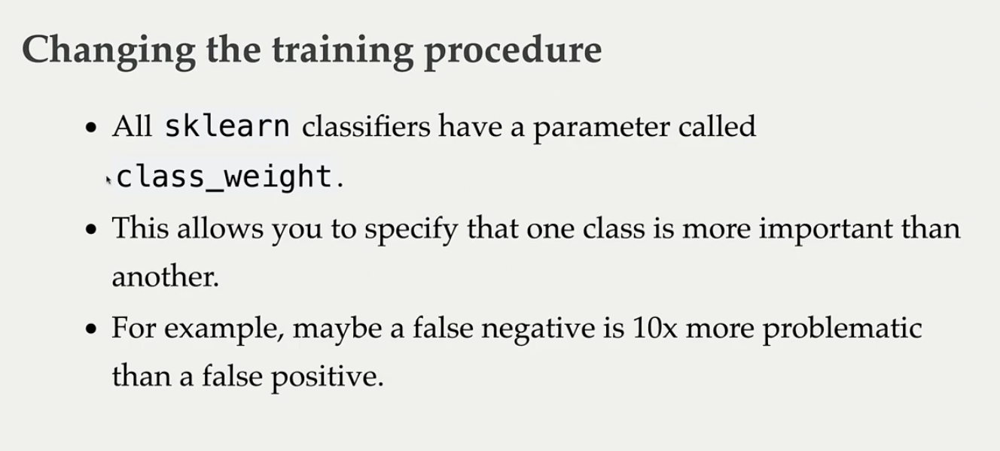

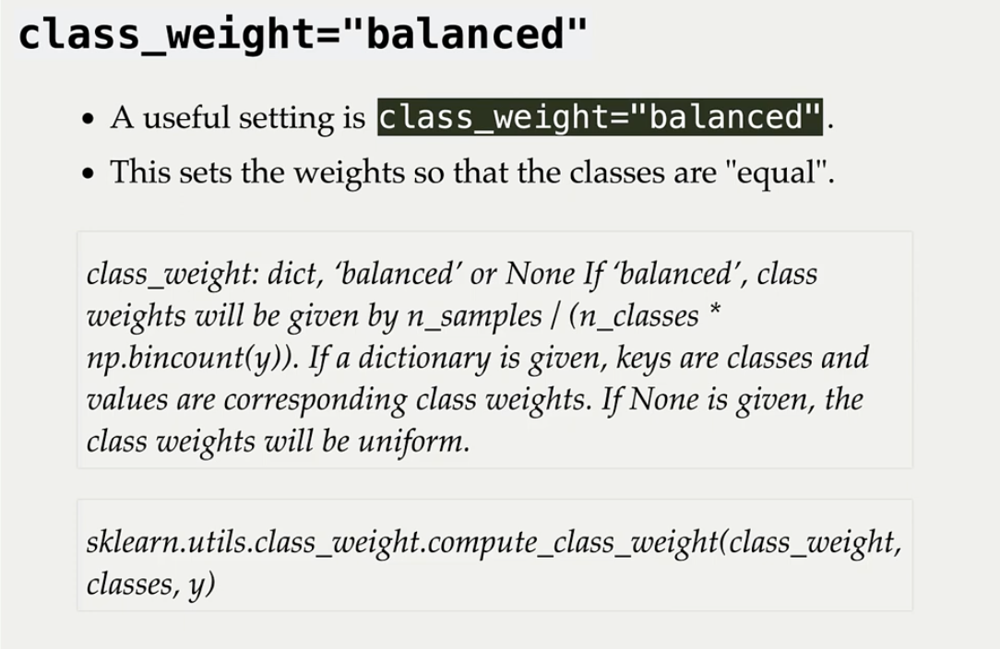

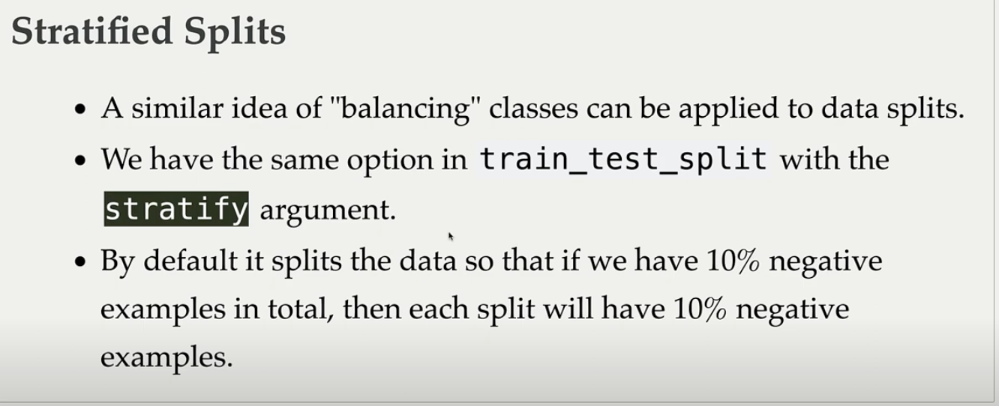

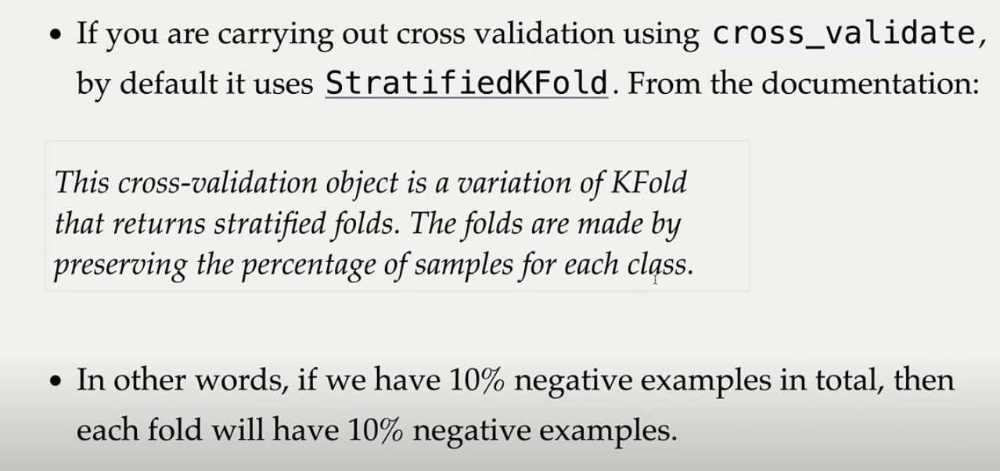

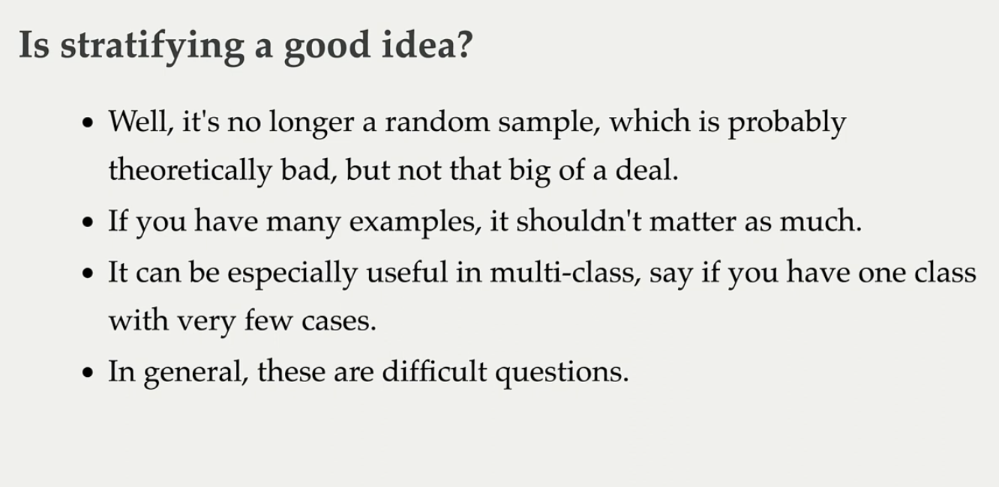


### 10.1 Preprocessing 

* lots of room for improvement 
* using `SimpleImputer` for missing values 
    * in reality we'd want to go through this more carefully. 
    * we may also want to drop some columns that are almost entirely missing 
* check for outliers and do other exploratory data analysis (EDA) 


In [ ]:
from sklearn.compose import ColumnTransformer, make_column_transformer
numeric_transformer = make_pipeline(SimpleImputer(strategy="median"), StandardScaler())
ordninal_transformer_reg = make_pipeline(
    SimpleImputer(srategy="most_frequent"),
    OrdinalEncoder(categories=ordering_ordinal_reg),
)

ordinal_transformer_oth = make_pipeline(
    SimpleImputer(strategy="most_frequent"),
    OrdinalEncoder(categories=ordering_ordinal_oth),
)

categorical_transformer =make_pipeline(
    SimpleImputer(strategy="constant", fill_value="missing"),
    OneHotEncoder(handle_unknown="ignore", sparse=False),
)

preprocessor = make_column_trnasformer(
    ("drop", drop_freatures),
    (numeric_transformer, numeric_features),
    (ordinal_transformer_reg, ordinal_features_reg), 
    (ordinal_transformer_oth, ordinal_features_oth),
    (categorical_transformer, categorical_features), 
)
